In [1]:
#Load the DataFrame
from pathlib import Path
import pandas as pd

base_dir = Path.cwd()

retail = pd.read_excel(base_dir / "Online Retail.xlsx")

In [2]:
#Take a look at the DataFrame
retail

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
...,...,...,...,...,...,...,...,...
541904,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,12680.0,France
541905,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12680.0,France
541906,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,12680.0,France
541907,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,12680.0,France


In [3]:
#Convert InvoiceDate to datetime
retail['InvoiceDate'] = pd.to_datetime(retail['InvoiceDate'])

In [4]:
#Add total price of purchase as a column
retail['TotalPrice'] = retail['Quantity']*retail['UnitPrice']

In [5]:
#Convert CustomerID to int
retail.loc[~pd.isnull(retail['CustomerID']), 'CustomerID'] = retail.loc[~pd.isnull(retail['CustomerID']), 'CustomerID'].astype(int)

In [6]:
#See how many different customers we have
len(retail['CustomerID'].unique())

4373

There are 4373 unique customers. This is important for RFM analysis. The scores will thus be on a scale 1-3 (see https://www.omniconvert.com/blog/rfm-score).


For R: we first create a new DataFrame whose rows are unique customers, and whose columns are customer IDs and their most recent purchase.

In [7]:
#Get the unique customers
unique_customers = pd.DataFrame(retail['CustomerID'].unique())

In [8]:
#Rename the column in unique_customers to 'CustomerID'
unique_customers.columns = ['CustomerID']

#Get the date of each customer's most recent purchase
last_purchases = retail.groupby('CustomerID').apply(lambda df: df.loc[df.InvoiceDate.idxmax()])
last_purchases = last_purchases[['CustomerID', 'InvoiceDate']]

#Take a look at the earliest and latest most recent purchase
print(min(last_purchases['InvoiceDate']))
print(max(last_purchases['InvoiceDate']))

2010-12-01 09:53:00
2011-12-09 12:50:00


C:\Users\User\AppData\Local\Temp\ipykernel_5768\330651136.py:5: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  last_purchases = retail.groupby('CustomerID').apply(lambda df: df.loc[df.InvoiceDate.idxmax()])


Ok, so the earliest latest purchase made by a customer is the very first day (Dec. 1, 2010) and the latest latest purchase made by a customer is the last day (Dec. 9, 2011). This is 365+8=373 days that we need to divide into 3 categories: 373/3 is approx. equal to 124. So a recency score of 1 is assigned to the customers who made their last order between Dec. 1, 2010 and ...

In [9]:
#Divide the interval before the earliest and latest most recent purchase into 3 intervals. It turns out the one third is around 124 days.
from datetime import datetime, timedelta

first_day = min(last_purchases['InvoiceDate'])
end_of_first_interval = first_day + timedelta(days = 124)
end_of_second_interval = end_of_first_interval + timedelta(days = 124)
end_of_third_interval = max(last_purchases['InvoiceDate'])
last_purchases['RecencyScore'] = 1
last_purchases.loc[(last_purchases['InvoiceDate'] > end_of_first_interval) & (last_purchases['InvoiceDate'] <= end_of_second_interval), 'RecencyScore'] = 2
last_purchases.loc[(last_purchases['InvoiceDate'] > end_of_second_interval) & (last_purchases['InvoiceDate'] <= end_of_third_interval), 'RecencyScore'] = 3

In [10]:
last_purchases.groupby('RecencyScore').RecencyScore.count()

RecencyScore
1     506
2     694
3    3172
Name: RecencyScore, dtype: int64

In [11]:
end_of_first_interval, end_of_second_interval

(Timestamp('2011-04-04 09:53:00'), Timestamp('2011-08-06 09:53:00'))

Now it's time for frequency. First we look at how many orders each customer made, and what the minimal and maximal values are.

In [12]:
order_count = retail.groupby('CustomerID').CustomerID.count()

In [13]:
min(order_count), max(order_count)

(1, 7983)

In [14]:
order_count

CustomerID
12346.0      2
12347.0    182
12348.0     31
12349.0     73
12350.0     17
          ... 
18280.0     10
18281.0      7
18282.0     13
18283.0    756
18287.0     70
Name: CustomerID, Length: 4372, dtype: int64

OK, there are probably some outliers. Let's try to find the number such that 1/3 of the customers ordered less times than that number, and the same with 2/3 ("thirdile", "tertile"?) Yep, tertile :).

In [15]:
order_count = pd.DataFrame(order_count)
order_count.columns = ['NumberOrders']
order_count

,NumberOrders
CustomerID,
12346.0,2
12347.0,182
12348.0,31
12349.0,73
12350.0,17
...,...
18280.0,10
18281.0,7
18282.0,13


In [16]:
4373/3

1457.6666666666667

In [17]:
import numpy as np

#A function that returns the first and second tertile numbers...

def find_tertiles(table, col):
    min_value = min(table[col])
    max_value = max(table[col])
    first_tertile_count = 0
    second_tertile_count = 0
    found_first_tertile = found_second_tertile = False
    first_tertile_number = 0
    second_tertile_number = 0
    values = table[col].unique()
    values.sort()
    
    for i in values:
        rows_with_value_i = table.loc[table[col] == i]
        if not found_first_tertile:
            first_tertile_count += len(rows_with_value_i)
            if first_tertile_count > len(table)/3:
                found_first_tertile = True
                first_tertile_number = i
        if not found_second_tertile:
            second_tertile_count += len(rows_with_value_i)
            if second_tertile_count > (2*len(table))/3:
                found_second_tertile = True
                second_tertile_number = i
    
    return first_tertile_number, second_tertile_number


first_tertile_number, second_tertile_number = find_tertiles(order_count, 'NumberOrders')
first_tertile_number, second_tertile_number

(np.int64(24), np.int64(74))

In [18]:
rf_score = last_purchases
rf_score['NumberPurchases'] = order_count['NumberOrders']

In [19]:
#We now have Recency and Frequency.
rf_score['FrequencyScore'] = 1
rf_score.loc[rf_score['NumberPurchases'] > first_tertile_number, 'FrequencyScore'] = 2
rf_score.loc[rf_score['NumberPurchases'] > second_tertile_number, 'FrequencyScore'] = 3
rf_score

,CustomerID,InvoiceDate,RecencyScore,NumberPurchases,FrequencyScore
CustomerID,,,,,
12346.0,12346.0,2011-01-18 10:17:00,1,2,1
12347.0,12347.0,2011-12-07 15:52:00,3,182,3
12348.0,12348.0,2011-09-25 13:13:00,3,31,2
12349.0,12349.0,2011-11-21 09:51:00,3,73,2
12350.0,12350.0,2011-02-02 16:01:00,1,17,1
...,...,...,...,...,...
18280.0,18280.0,2011-03-07 09:52:00,1,10,1
18281.0,18281.0,2011-06-12 10:53:00,2,7,1
18282.0,18282.0,2011-12-02 11:43:00,3,13,1


In [20]:
#We now want to get the M score - M stands for 'Monetary Value'. We compute how much each customer spent in total.
money_spent = retail.groupby('CustomerID').TotalPrice.sum()
money_spent

CustomerID
12346.0       0.00
12347.0    4310.00
12348.0    1797.24
12349.0    1757.55
12350.0     334.40
            ...   
18280.0     180.60
18281.0      80.82
18282.0     176.60
18283.0    2094.88
18287.0    1837.28
Name: TotalPrice, Length: 4372, dtype: float64

In [21]:
#We get the first and second tertile for monetary value...
rfm_score = rf_score
rfm_score['MoneySpent'] = money_spent
first_tertile_monetary, second_tertile_monetary = find_tertiles(rfm_score, 'MoneySpent')
first_tertile_monetary, second_tertile_monetary

(np.float64(374.57), np.float64(1141.24))

In [22]:
#... and assign the M scores appropriately.
rfm_score['MonetaryValueScore'] = 1
rfm_score.loc[rfm_score['MoneySpent'] > first_tertile_monetary, 'MonetaryValueScore'] = 2
rfm_score.loc[rfm_score['MoneySpent'] > second_tertile_monetary, 'MonetaryValueScore'] = 3
rfm_score

,CustomerID,InvoiceDate,RecencyScore,NumberPurchases,FrequencyScore,MoneySpent,MonetaryValueScore
CustomerID,,,,,,,
12346.0,12346.0,2011-01-18 10:17:00,1,2,1,0.00,1
12347.0,12347.0,2011-12-07 15:52:00,3,182,3,4310.00,3
12348.0,12348.0,2011-09-25 13:13:00,3,31,2,1797.24,3
12349.0,12349.0,2011-11-21 09:51:00,3,73,2,1757.55,3
12350.0,12350.0,2011-02-02 16:01:00,1,17,1,334.40,1
...,...,...,...,...,...,...,...
18280.0,18280.0,2011-03-07 09:52:00,1,10,1,180.60,1
18281.0,18281.0,2011-06-12 10:53:00,2,7,1,80.82,1
18282.0,18282.0,2011-12-02 11:43:00,3,13,1,176.60,1


In [23]:
#We isolate the R, F and M scores into a new DataFrame.
rfm_df = rfm_score[['RecencyScore', 'FrequencyScore', 'MonetaryValueScore']]
rfm_df

,RecencyScore,FrequencyScore,MonetaryValueScore
CustomerID,,,
12346.0,1,1,1
12347.0,3,3,3
12348.0,3,2,3
12349.0,3,2,3
12350.0,1,1,1
...,...,...,...
18280.0,1,1,1
18281.0,2,1,1
18282.0,3,1,1


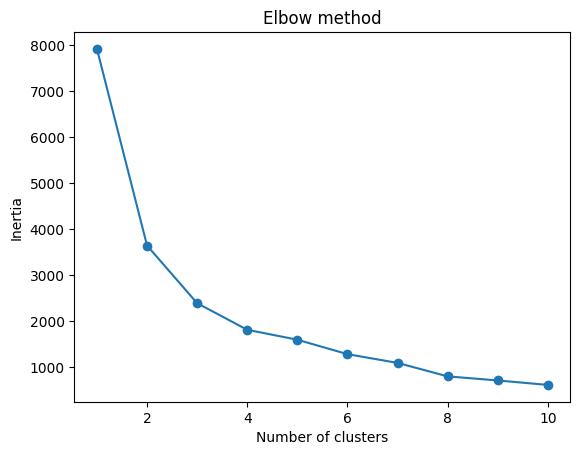

In [24]:
#Time to make clusters! For each k between 1 and 10 (here it's named i), we perform K-means for that value and plot the inertia.
#We use the elbow method and we note that the functions elbow is around k=2 and k=3. 
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

inertias = []

for i in range(1,11):
    kmeans = KMeans(n_clusters = i)
    kmeans.fit(rfm_df)
    inertias.append(kmeans.inertia_)

plt.plot(range(1,11), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

k = 3 probably works the best. Let's see which of the 27 combinations was assigned to each cluster.

In [25]:
#Fit the data for k=3.
kmeans = KMeans(n_clusters=3)
kmeans.fit(rfm_df)

# Generate all possible combinations of 1, 2, 3 in 3 columns
combinations = pd.DataFrame([(x, y, z) for x in [1, 2, 3] for y in [1, 2, 3] for z in [1, 2, 3]],
                            columns=['col1', 'col2', 'col3'])
combinations.columns = ['RecencyScore', 'FrequencyScore', 'MonetaryValueScore']
# Predict the cluster for each combination
combinations['Cluster'] = kmeans.predict(combinations)
# Group by cluster
grouped = combinations.groupby('Cluster')
for cluster, group in grouped:
    print(f"Cluster {cluster}:")
    print(group)
    print()

Cluster 0:
    RecencyScore  FrequencyScore  MonetaryValueScore  Cluster
5              1               2                   3        0
7              1               3                   2        0
8              1               3                   3        0
11             2               1                   3        0
13             2               2                   2        0
14             2               2                   3        0
15             2               3                   1        0
16             2               3                   2        0
17             2               3                   3        0
20             3               1                   3        0
22             3               2                   2        0
23             3               2                   3        0
24             3               3                   1        0
25             3               3                   2        0
26             3               3                   3       

In [26]:
#Let's find the silhouette score of this clustering
from sklearn.metrics import silhouette_score

kmeans_labels = kmeans.labels_
sil_score = silhouette_score(rfm_df, kmeans_labels)
sil_score

np.float64(0.4892243392076833)

### K-means Clustering Conclusion

In the *first* cluster, the frequency and recency scores are quite high. These are the **heavy hitters** - although some of them haven't bought from us in a while, they have relateively high frequency and have spent a significant amount of money on our platform.

In the *second* cluster, people either aren't buying from us anymore, or have not spent much money on our platform. These are the **light shoppers**.

In the *third* cluster, we have **recent buyers**. All of them have a recency score of 2 or 3, most of 3.

The silhouette score is pretty decent.

### Additional Metrics

In what follows, we compute some misceallaneous metrics - revenue by segment, customer lifetime value (already computed), and we label each buyer according to their "flight risk" - *no danger*, *be careful* or *in danger*. This should give some idea about the churn risk

In [27]:
#We take the labels given by KMeans and turn them into a Series, that we then join as a column to rfm_score
labelSeries = pd.Series(kmeans.labels_, name="Label")
rfm_score.reset_index(drop=True, inplace=True)
rfm_score_with_labels = pd.concat([rfm_score, labelSeries], axis=1)
#Revenue by segment is then obtained by a simple groupby 
revenue_by_segment = rfm_score_with_labels.groupby(["Label"]).MoneySpent.sum()
revenue_by_segment

Label
0    7805126.453
1     239065.350
2     255874.011
Name: MoneySpent, dtype: float64

In [28]:
#The customer lifetime value is already contained in the MoneySpent column
customer_lifetime_value = rfm_score[['CustomerID', 'MoneySpent']]
customer_lifetime_value.set_index('CustomerID', inplace=True)
customer_lifetime_value

,MoneySpent
CustomerID,
12346.0,0.00
12347.0,4310.00
12348.0,1797.24
12349.0,1757.55
12350.0,334.40
...,...
18280.0,180.60
18281.0,80.82
18282.0,176.60


In [29]:
#We compute the "flight danger levels". If the R score is 1, and the M score 2 or 3, we are "in danger" of losing the customer.
#If the R score is 2 and the M score is 3, we should "be careful" - the customer might leave if we do nothing.
rfm_score['Danger Level'] = "No danger"
rfm_score.loc[(rfm_score['RecencyScore']==1) & (rfm_score['MonetaryValueScore'] >= 2), 'Danger Level'] = "In danger"
rfm_score.loc[(rfm_score['RecencyScore']==2) & (rfm_score['MonetaryValueScore'] == 3), 'Danger Level'] = "Be careful"
danger_counts = rfm_score.groupby('Danger Level').size()

The next goal is to get the data about the last purchase, the number of purchases and total money spent as coordinates of a 3D space and visualize the dataset!

Afterwards, we perform PCA on this dataset and visualize it in 2D.

In [30]:
#Get the earliest purchase date
first_purchase = min(retail['InvoiceDate'])
rfm_score['FirstPurchase'] = first_purchase

#Compute the number of seconds passed between the last purchase and the first purchase.
rfm_score['LastPurchaseTimeDelta'] = rfm_score['InvoiceDate'] - rfm_score['FirstPurchase']
rfm_score['LastPurchaseSeconds'] = rfm_score['LastPurchaseTimeDelta'].apply(lambda x : x.total_seconds())
rfm_score = rfm_score.drop(columns=['LastPurchaseTimeDelta', 'FirstPurchase'])

In [31]:
#Renormalize the 'number of seconds between last and first purchase' column to lie in (0,1)
max_seconds = max(rfm_score['LastPurchaseSeconds'])
min_seconds = min(rfm_score['LastPurchaseSeconds'])
rfm_score['LastPurchaseSeconds'] -= min_seconds
rfm_score['LastPurchaseSeconds'] /= (max_seconds - min_seconds)
rfm_score

,CustomerID,InvoiceDate,RecencyScore,NumberPurchases,FrequencyScore,MoneySpent,MonetaryValueScore,Danger Level,LastPurchaseSeconds
0,12346.0,2011-01-18 10:17:00,1,2,1,0.00,1,No danger,0.128689
1,12347.0,2011-12-07 15:52:00,3,182,3,4310.00,3,No danger,0.994979
2,12348.0,2011-09-25 13:13:00,3,31,2,1797.24,3,No danger,0.799037
3,12349.0,2011-11-21 09:51:00,3,73,2,1757.55,3,No danger,0.951425
4,12350.0,2011-02-02 16:01:00,1,17,1,334.40,1,No danger,0.169530
...,...,...,...,...,...,...,...,...,...
4367,18280.0,2011-03-07 09:52:00,1,10,1,180.60,1,No danger,0.257286
4368,18281.0,2011-06-12 10:53:00,2,7,1,80.82,1,No danger,0.517367
4369,18282.0,2011-12-02 11:43:00,3,13,1,176.60,1,No danger,0.981115
4370,18283.0,2011-12-06 12:02:00,3,756,3,2094.88,3,No danger,0.991870


In [32]:
#Define the "standardize" function, to make values lie in (0,1)
def standardize(column):
    min_value = min(column)
    max_value = max(column)
    column -= min_value
    column /= (max_value - min_value)
    return column

In [33]:
#Standardize number of purchases and money spent
rfm_score['NumberPurchases'] = standardize(rfm_score['NumberPurchases'])
rfm_score['MoneySpent'] = standardize(rfm_score['MoneySpent'])

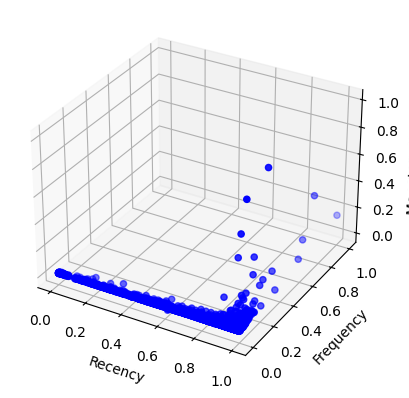

In [34]:
#Plot the dataset
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(rfm_score['LastPurchaseSeconds'], rfm_score['NumberPurchases'], rfm_score['MoneySpent'], c='blue', marker='o')

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary Value')

plt.show()

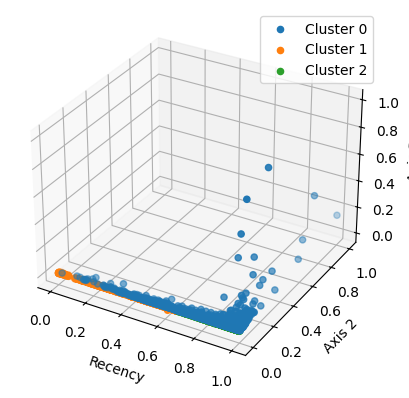

In [35]:
#Bottom-heavy! The frequency and monetary value scores are mostly *very low*! 
#Now let's color these points according to clusters.

#Get the labels and the numerical values of RFM, rescaled to lie in (0,1).
labels = kmeans.labels_
unique_labels = np.unique(labels)
rfm_numeric = rfm_score[['LastPurchaseSeconds', 'NumberPurchases', 'MoneySpent']]
rfm_numeric = pd.concat([rfm_numeric,pd.Series(labels)], axis=1)
rfm_numeric.columns = ['LastPurchaseSeconds', 'NumberPurchases', 'MoneySpent', 'Label']
# Create a scatter plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

#Plot each cluster, one at a time
for label in unique_labels:
    x_coords = rfm_numeric.loc[rfm_numeric['Label']==label, 'LastPurchaseSeconds'].to_list()
    y_coords = rfm_numeric.loc[rfm_numeric['Label']==label, 'NumberPurchases'].to_list()
    z_coords = rfm_numeric.loc[rfm_numeric['Label']==label, 'MoneySpent'].to_list()
    # Plot the points
    ax.scatter(
        x_coords, y_coords, z_coords,
        label=f'Cluster {label}',
    )

# Add labels and legend
ax.set_xlabel('Recency')
ax.set_ylabel('Axis 2')
ax.set_zlabel('Axis 3')
plt.legend()
plt.show()

Now let's do 2D visualization with PCA!

In [36]:
from sklearn.decomposition import PCA

projector = PCA(n_components=2)
rfm_projected = projector.fit_transform(rfm_numeric)
rfm_projected_list = []
for i in range(rfm_projected.shape[0]):
    rfm_projected_list.append(rfm_projected[i])
rfm_projected = pd.Series(rfm_projected_list)
rfm_projected = pd.concat([rfm_projected, pd.Series(labels)], axis = 1)
rfm_projected.columns = ["Coordinates", "Label"]

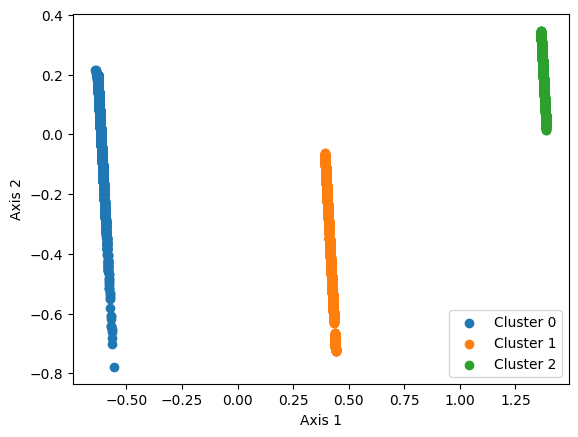

In [37]:
labels = kmeans.labels_

# Create a scatter plot
fig = plt.figure()
ax = fig.add_subplot(111)

# Assign colors to clusters
for label in unique_labels:
    coords = rfm_projected.loc[rfm_projected['Label']==label, 'Coordinates']
    x_coords = []
    y_coords = []
    for point in coords:
        x_coords.append(point[0])
        y_coords.append(point[1])
    # Plot the points
    ax.scatter(
        x_coords, y_coords,
        label=f'Cluster {label}',
    )

# Add labels and legend
ax.set_xlabel('Axis 1')
ax.set_ylabel('Axis 2')
plt.legend()
plt.show()

Wow, PCA separates these values *very* well!

## KMeans Clustering on the RFM DataFrame - Conclusion

The clustering went quite well. We computed the RFM scores, revenue by segment, customer lifetime value, churn risk, and we visualized the data in both 3D and 2D using PCA.

Now let's try DBSCAN!

In [38]:
rfm_score.to_csv(base_dir / "rfm_score.csv")

So for DBSCAN, it doesn't make sense to cluster according to RFM scores, since there are only 27 different combinations, and the way DBSCAN works, taking balls around points and grouping the nearby ones into the same cluster, the clusters would sort of be predetermined.

It's better to convert the most recent purchase date into a float, rescale all three columns (most recent purchase, number of purchases and total money spent) to lie in (0,1) (which we already did when we plotted) and then perform DBSCAN for various radii.

To perform DBSCAN, we need to select eps and min_samples. To get the right idea of what these values should be, let's try to plot the dataset.

Looking at the 3D scatter plot above, we notice that many points have very small frequency and monetary value, probably because of extreme outliers. Let's remove the outliers (frequency > 0.5 or recency > 0.5) and plot again.

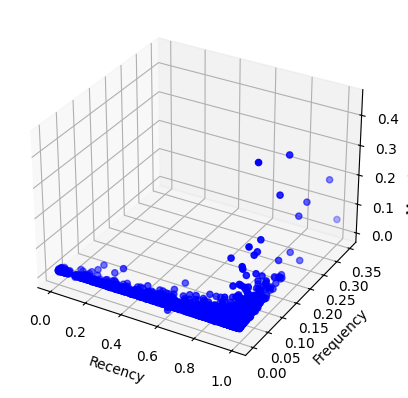

In [39]:
outliers_1 = rfm_score.loc[(rfm_score['NumberPurchases'] >= 0.5) | (rfm_score['MoneySpent'] >= 0.5)]
rfm_score_1 = rfm_score.loc[(rfm_score['NumberPurchases'] < 0.5) & (rfm_score['MoneySpent'] < 0.5)]
         
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(rfm_score_1['LastPurchaseSeconds'], rfm_score_1['NumberPurchases'], rfm_score_1['MoneySpent'], c='blue', marker='o')

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary Value')

plt.show()

It's better, but the outliers are still too big to see any non-trivial clusters. Let's cut off anything with frequency or monetary value > 0.25.

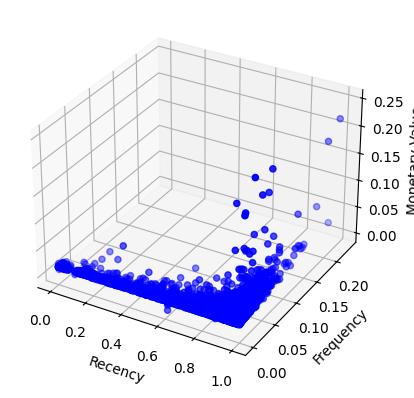

In [40]:
outliers_2 = rfm_score.loc[(rfm_score['NumberPurchases'] >= 0.25) | (rfm_score['MoneySpent'] >= 0.25)]
rfm_score_2 = rfm_score.loc[(rfm_score['NumberPurchases'] < 0.25) & (rfm_score['MoneySpent'] < 0.25)]
         
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(rfm_score_2['LastPurchaseSeconds'], rfm_score_2['NumberPurchases'], rfm_score_2['MoneySpent'], c='blue', marker='o')

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary Value')

plt.show()

Again!

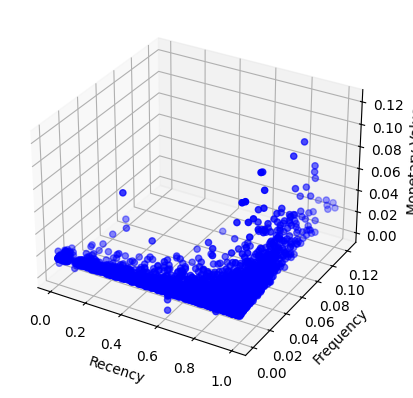

In [41]:
outliers_3 = rfm_score.loc[(rfm_score['NumberPurchases'] >= 0.125) | (rfm_score['MoneySpent'] >= 0.125)]
rfm_score_3 = rfm_score.loc[(rfm_score['NumberPurchases'] < 0.125) & (rfm_score['MoneySpent'] < 0.125)]
         
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(rfm_score_3['LastPurchaseSeconds'], rfm_score_3['NumberPurchases'], rfm_score_3['MoneySpent'], c='blue', marker='o')

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary Value')

plt.show()

... And again!

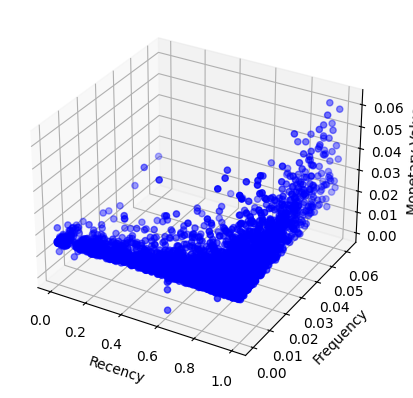

In [42]:
outliers_4 = rfm_score.loc[(rfm_score['NumberPurchases'] >= 0.0625) | (rfm_score['MoneySpent'] >= 0.0625)]
rfm_score_4 = rfm_score.loc[(rfm_score['NumberPurchases'] < 0.0625) & (rfm_score['MoneySpent'] < 0.0625)]
         
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(rfm_score_4['LastPurchaseSeconds'], rfm_score_4['NumberPurchases'], rfm_score_4['MoneySpent'], c='blue', marker='o')

ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary Value')

plt.show()

Honestly, it doesn't really seem like there are any clusters. But let's run the algorithm.

0.01, 5


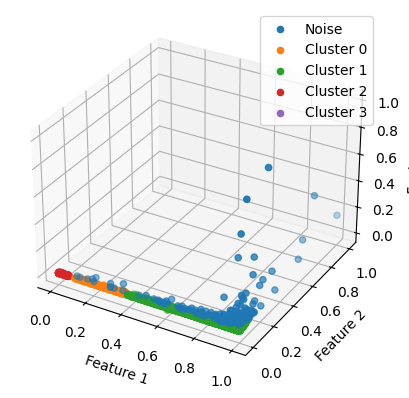

175
0.01, 10


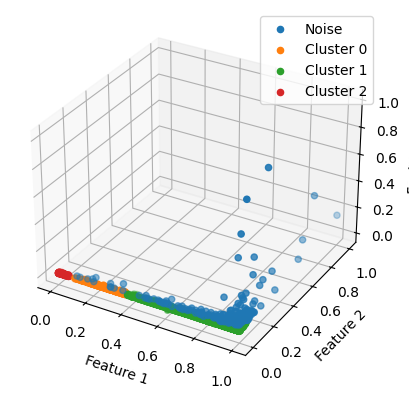

248
0.01, 15


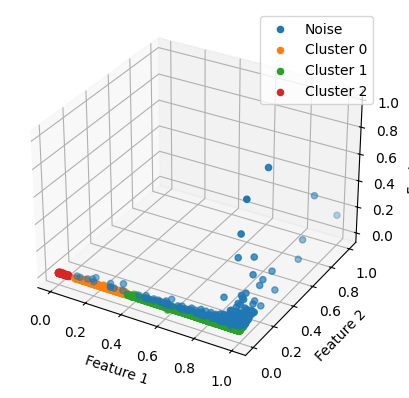

307
0.01, 20


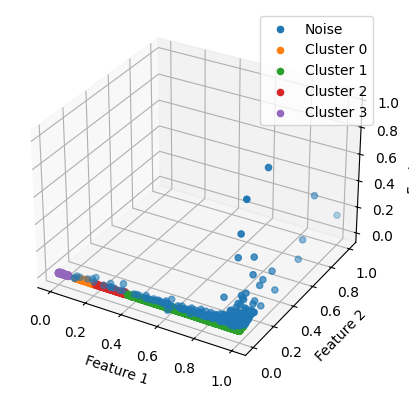

335
0.01, 25


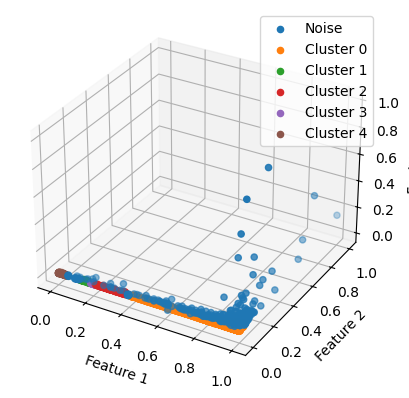

430
0.01, 30


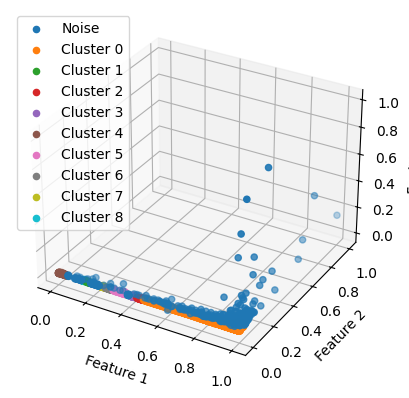

529
0.01, 35


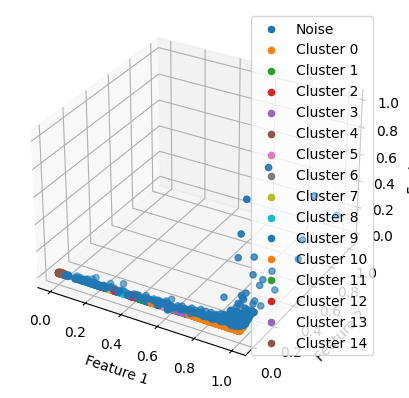

690
0.01, 40


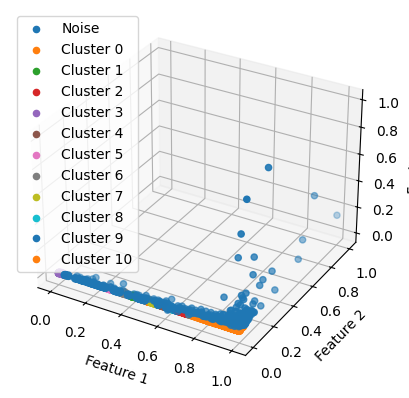

994
0.01, 45


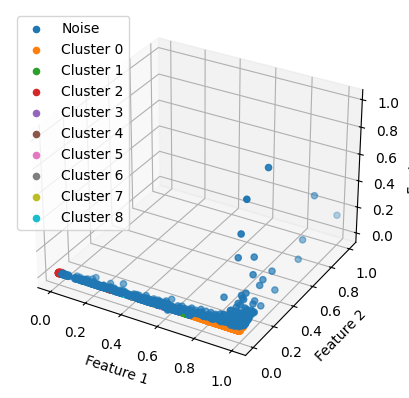

1306
0.01, 50


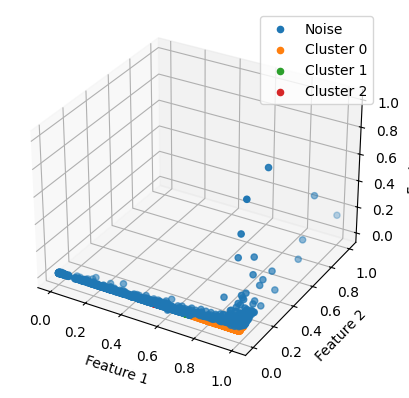

1681
0.01, 55


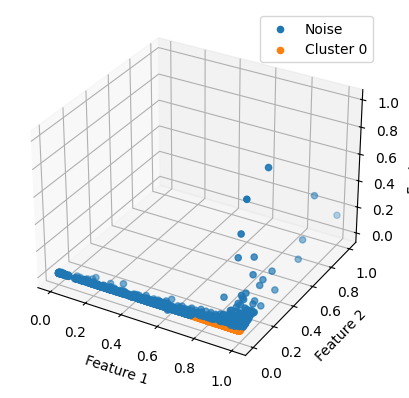

1822
0.01, 60


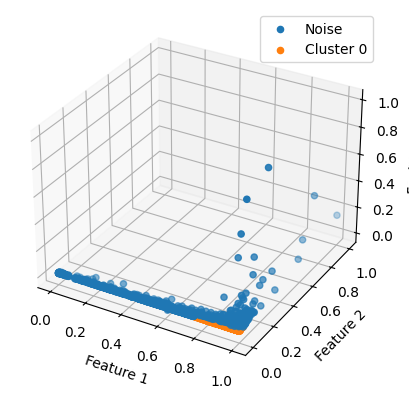

1879
0.01, 65


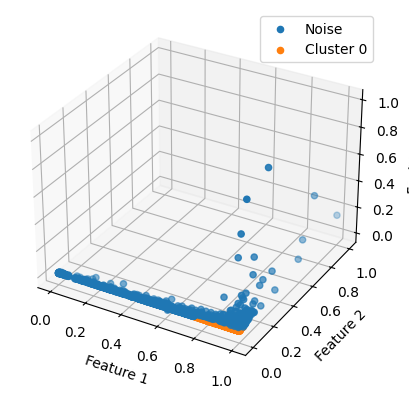

1897
0.01, 70


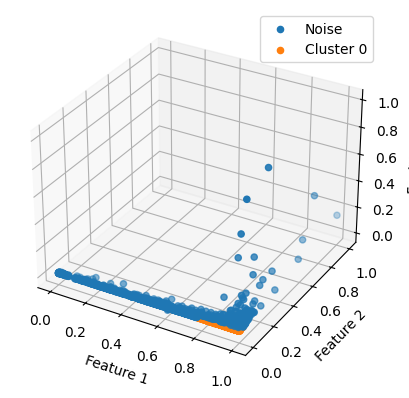

1959
0.01, 75


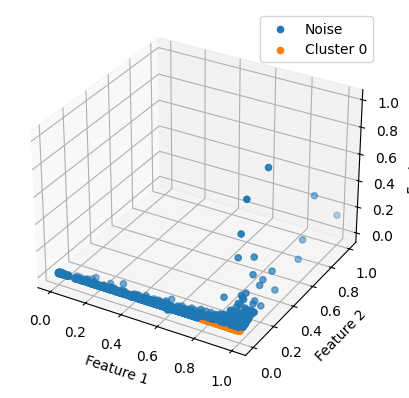

2004
0.01, 80


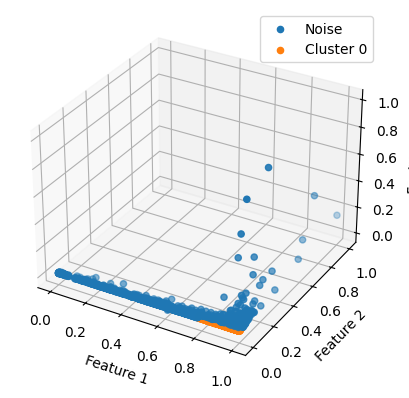

2020
0.01, 85


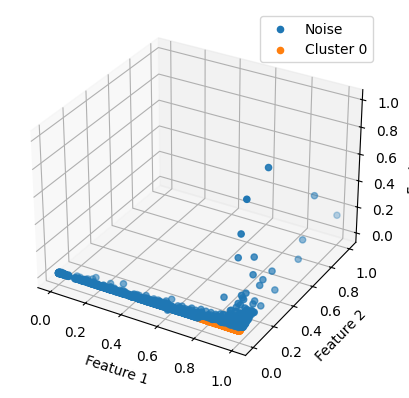

2047
0.01, 90


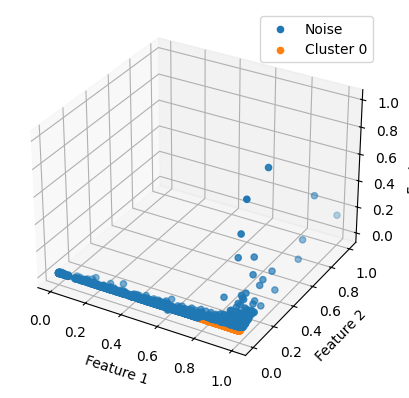

2054
0.01, 95


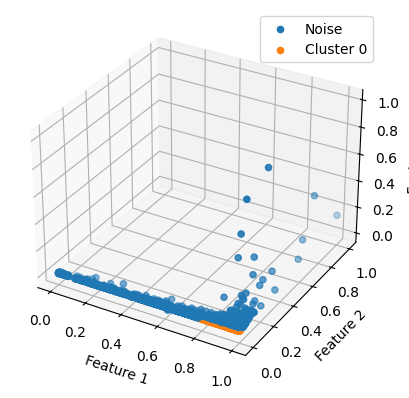

2080
0.01, 100


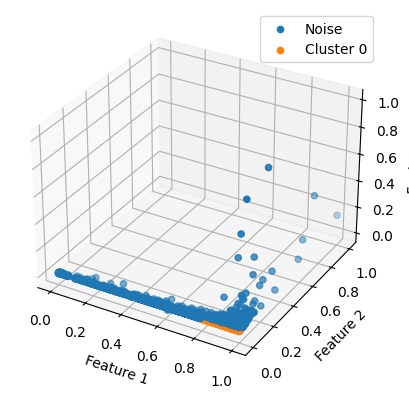

2125
0.02, 5


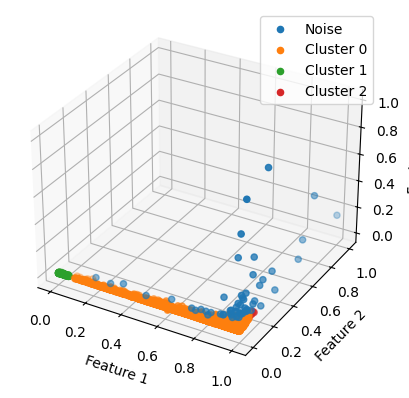

58
0.02, 10


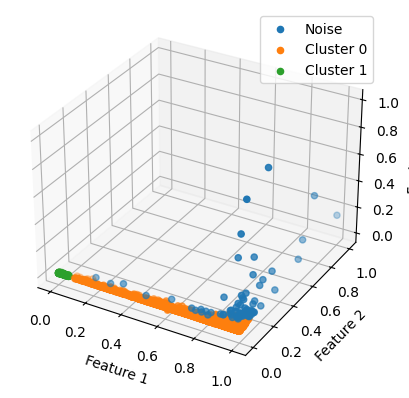

77
0.02, 15


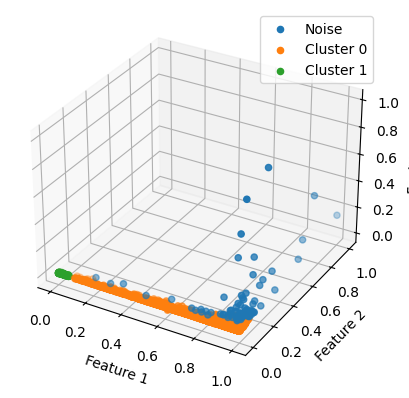

86
0.02, 20


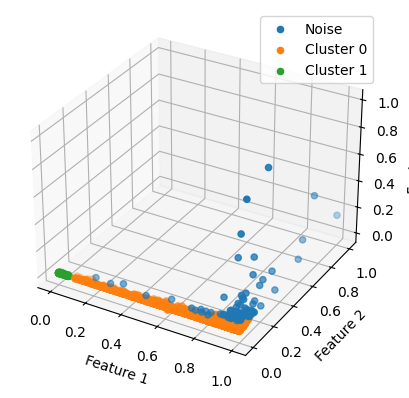

93
0.02, 25


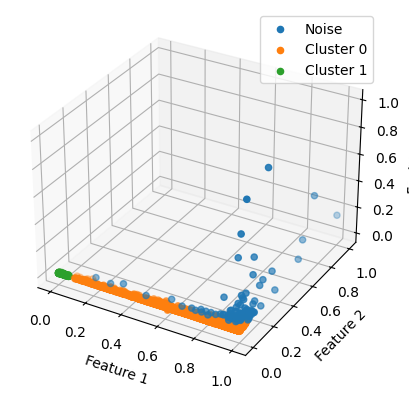

100
0.02, 30


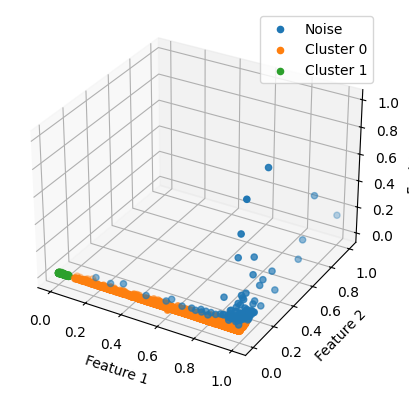

107
0.02, 35


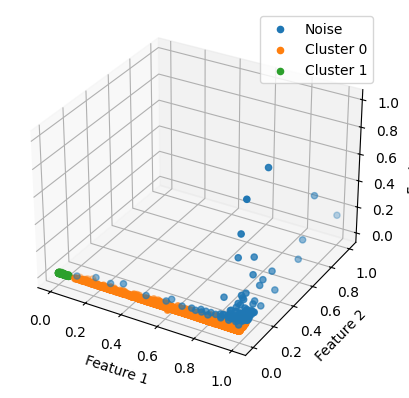

121
0.02, 40


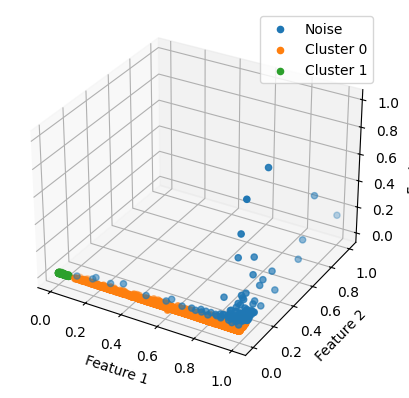

126
0.02, 45


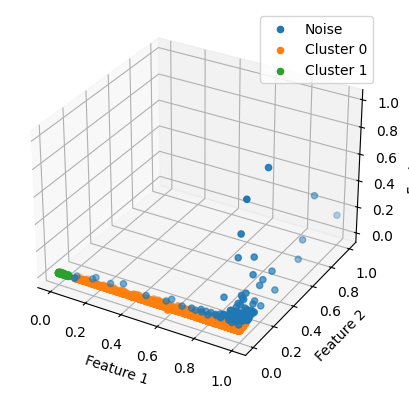

131
0.02, 50


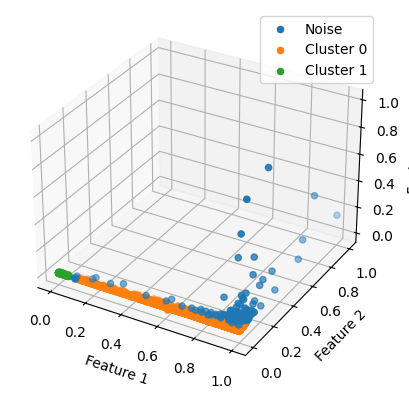

143
0.02, 55


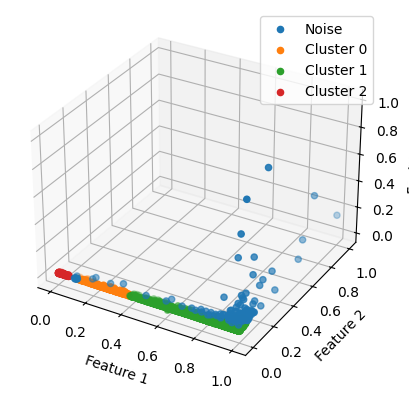

156
0.02, 60


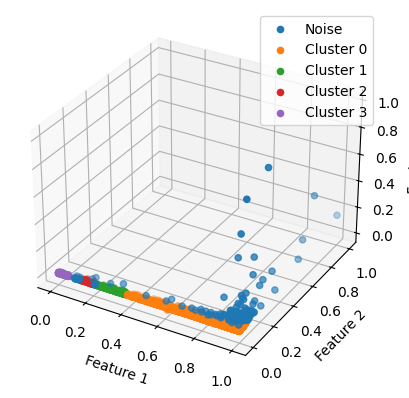

181
0.02, 65


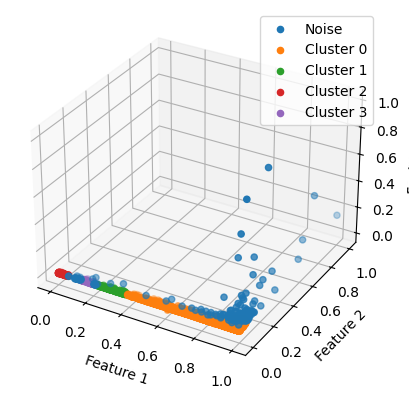

202
0.02, 70


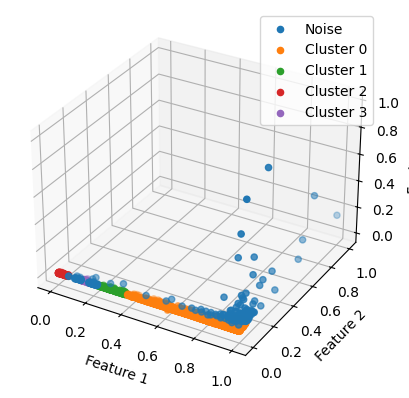

262
0.02, 75


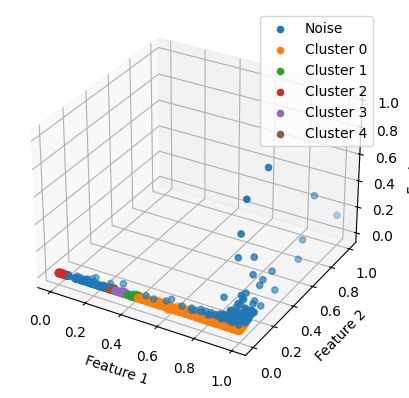

396
0.02, 80


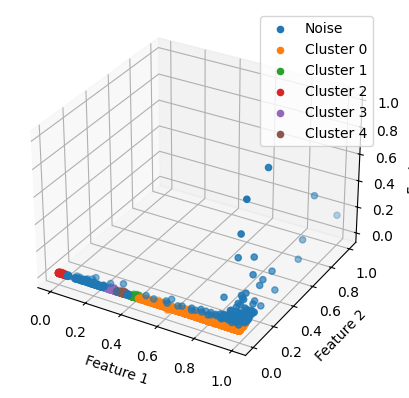

423
0.02, 85


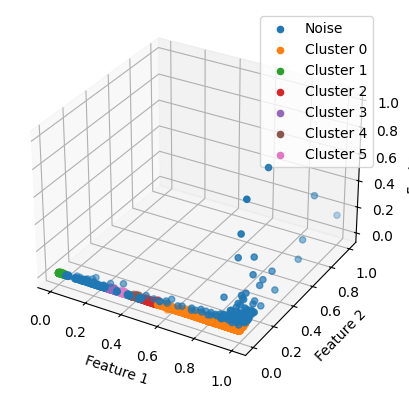

485
0.02, 90


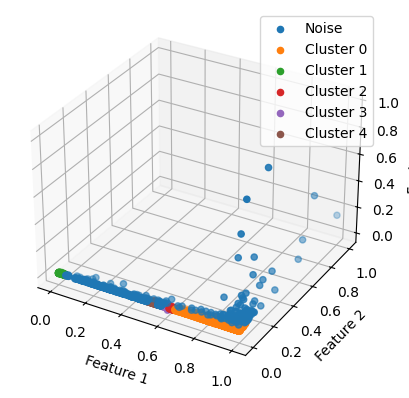

924
0.02, 95


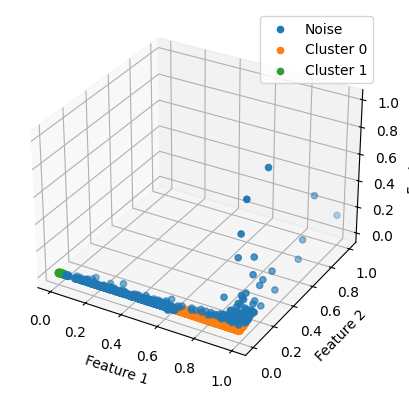

1218
0.02, 100


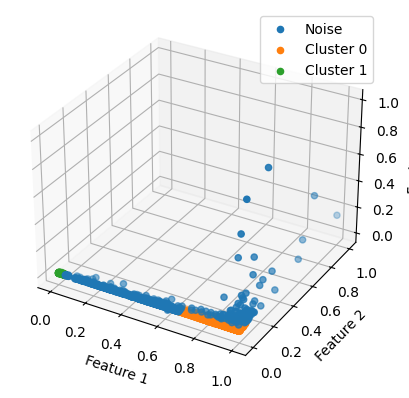

1277
0.03, 5


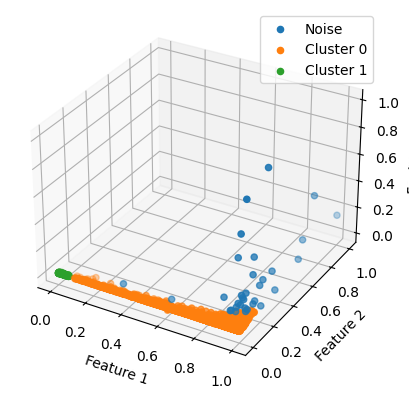

33
0.03, 10


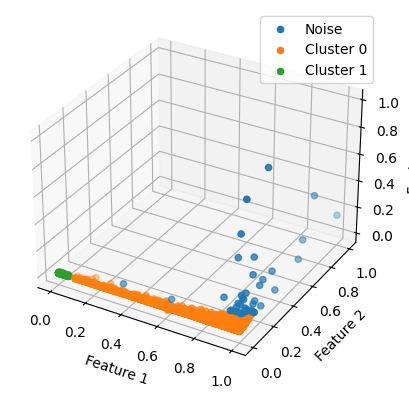

44
0.03, 15


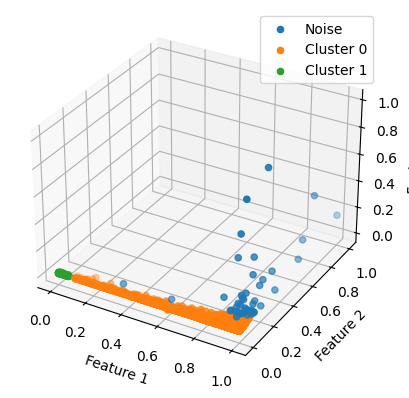

47
0.03, 20


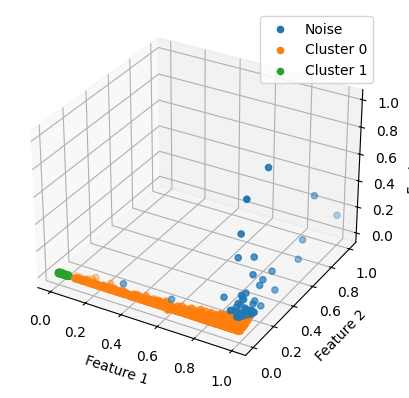

49
0.03, 25


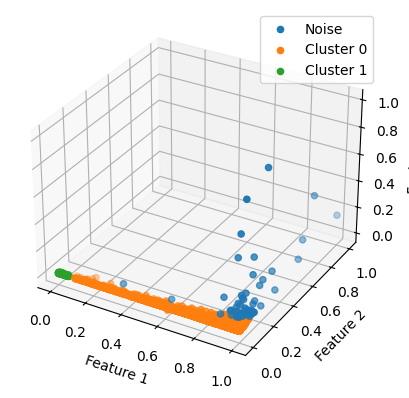

54
0.03, 30


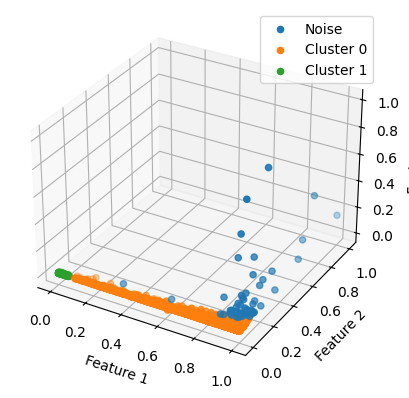

56
0.03, 35


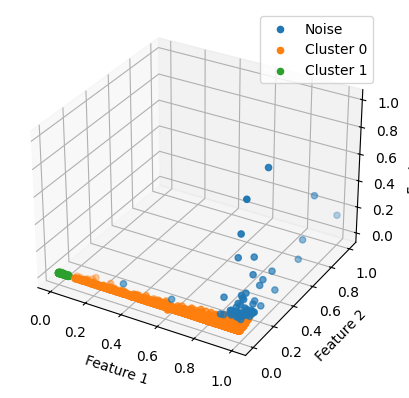

58
0.03, 40


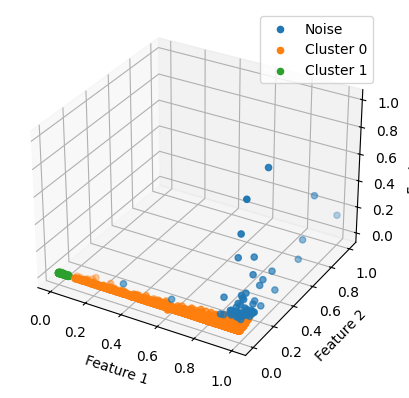

58
0.03, 45


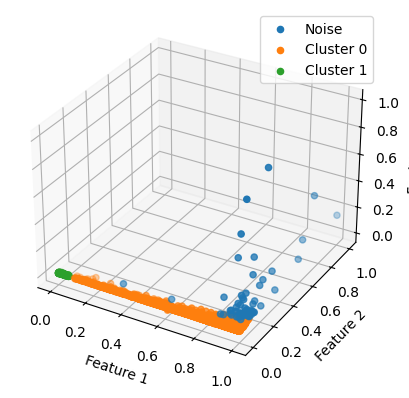

63
0.03, 50


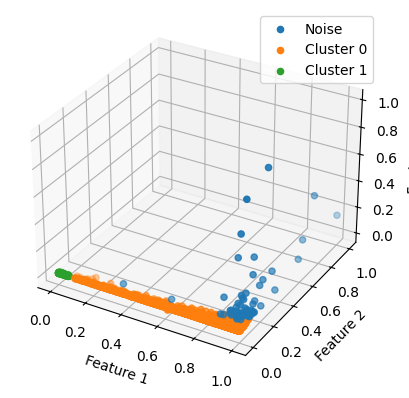

64
0.03, 55


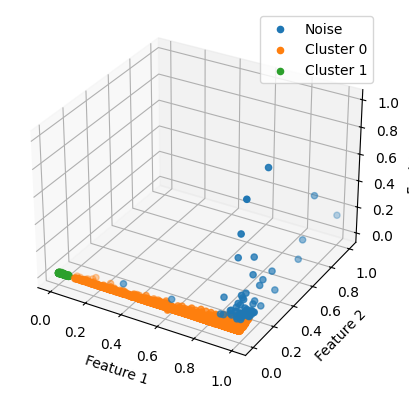

65
0.03, 60


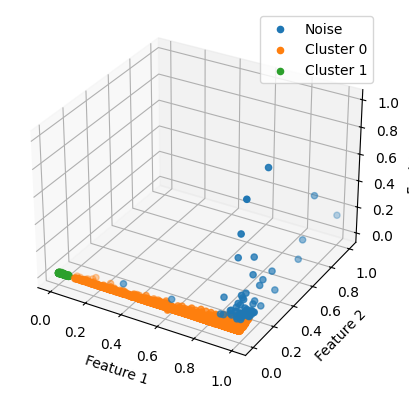

65
0.03, 65


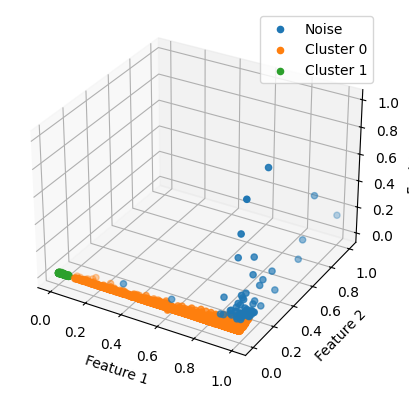

65
0.03, 70


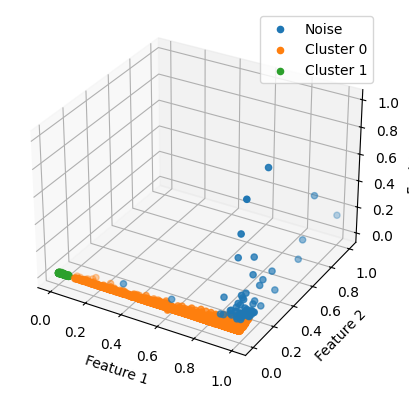

65
0.03, 75


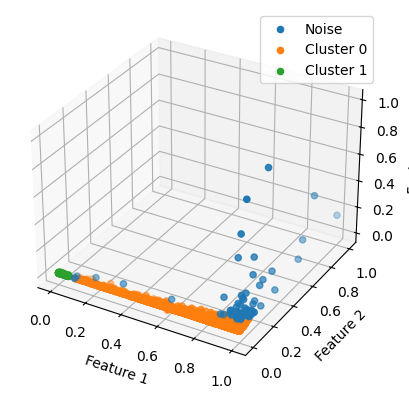

72
0.03, 80


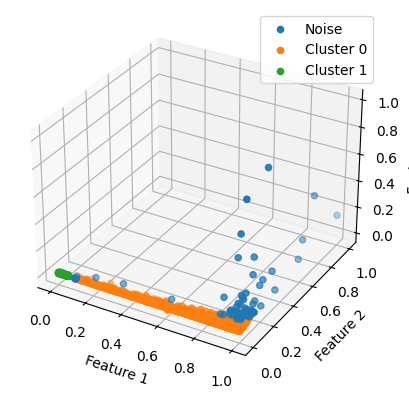

80
0.03, 85


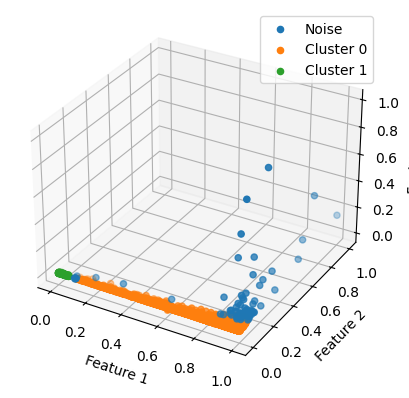

84
0.03, 90


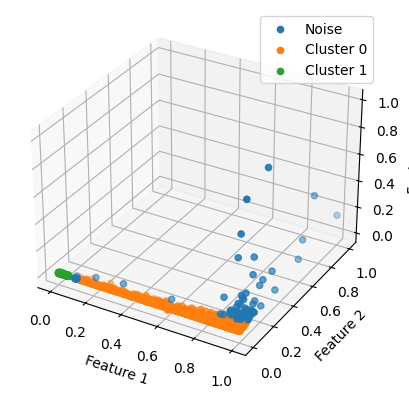

88
0.03, 95


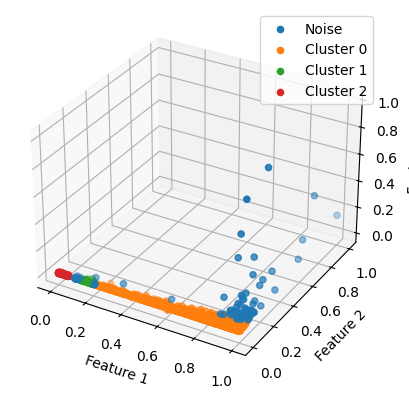

103
0.03, 100


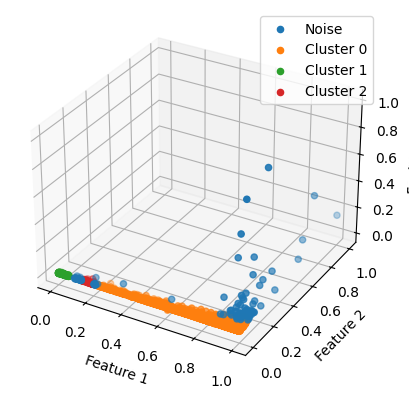

135
0.04, 5


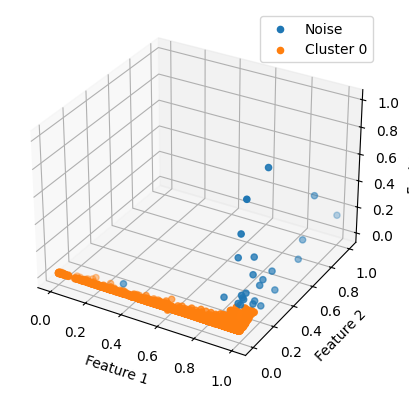

25
0.04, 10


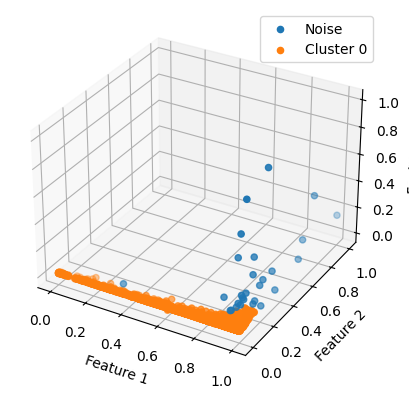

28
0.04, 15


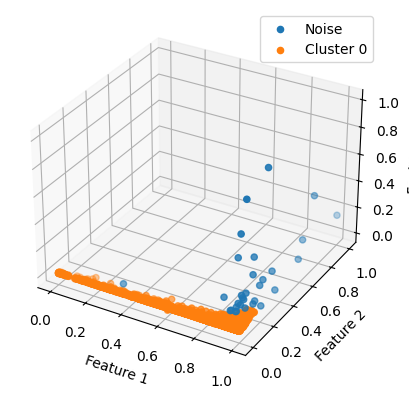

31
0.04, 20


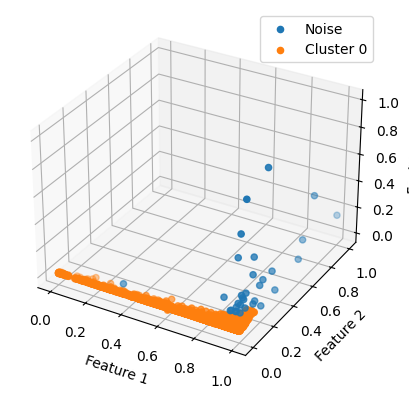

32
0.04, 25


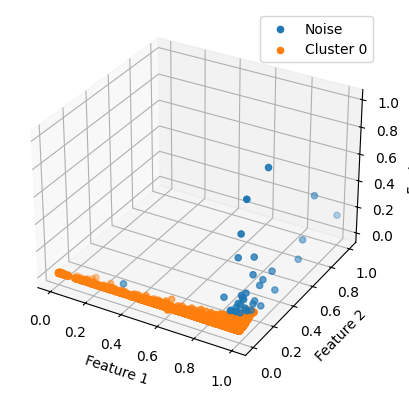

35
0.04, 30


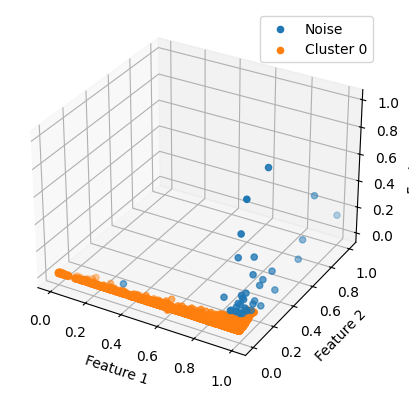

37
0.04, 35


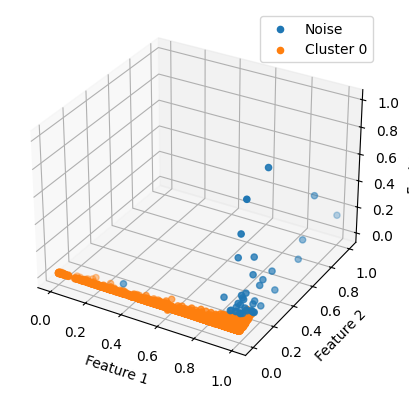

41
0.04, 40


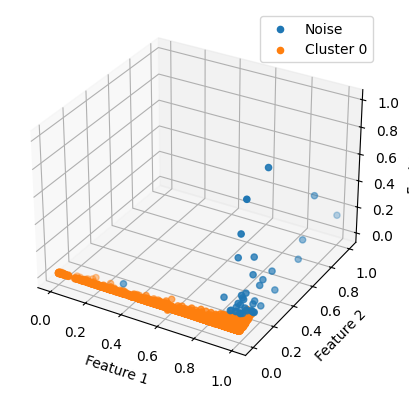

41
0.04, 45


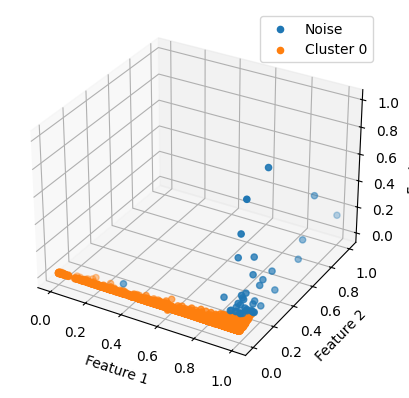

42
0.04, 50


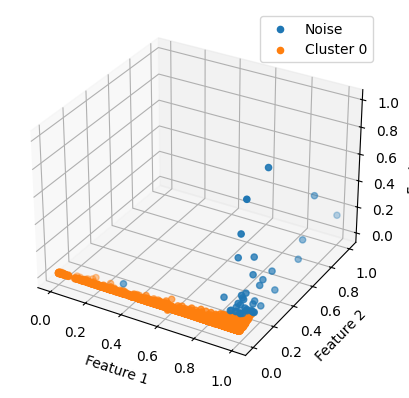

42
0.04, 55


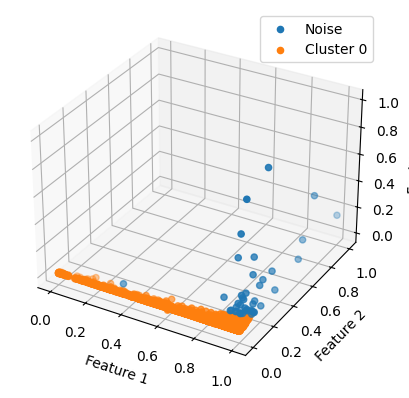

43
0.04, 60


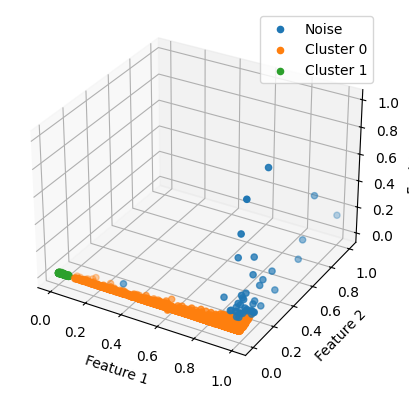

45
0.04, 65


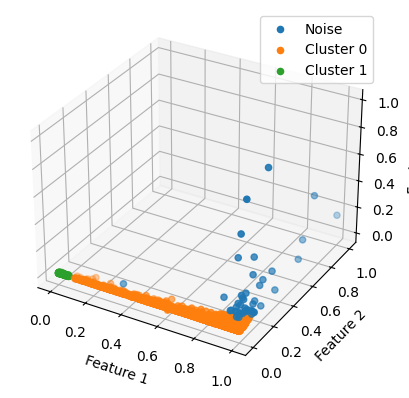

46
0.04, 70


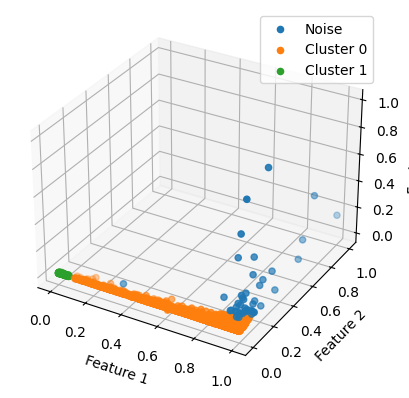

46
0.04, 75


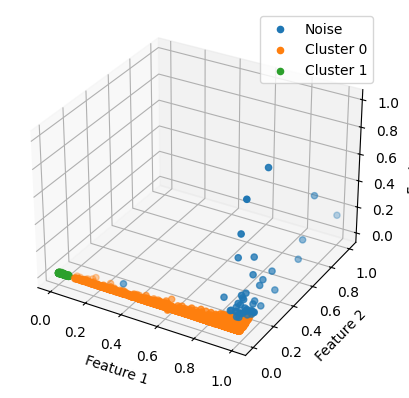

47
0.04, 80


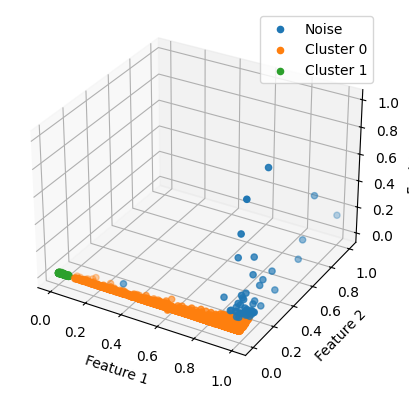

49
0.04, 85


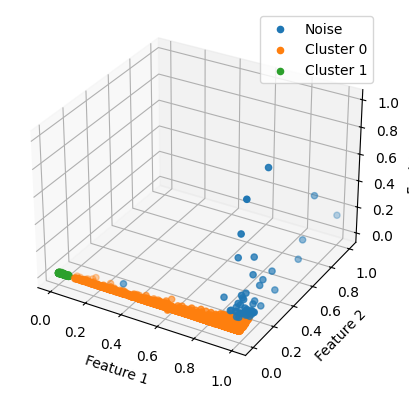

49
0.04, 90


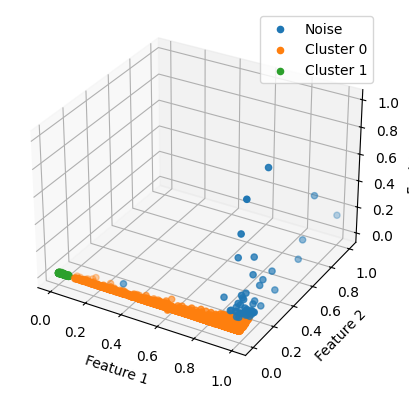

49
0.04, 95


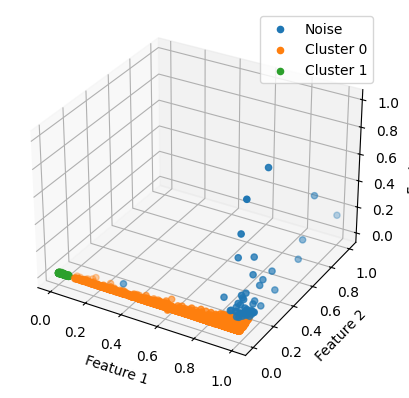

50
0.04, 100


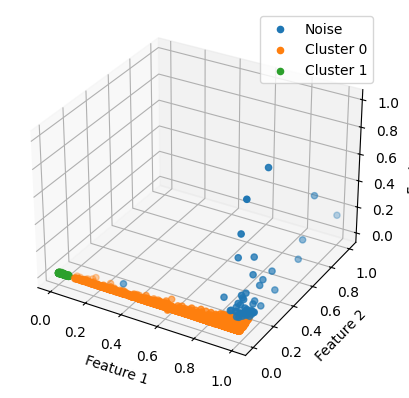

50
0.05, 5


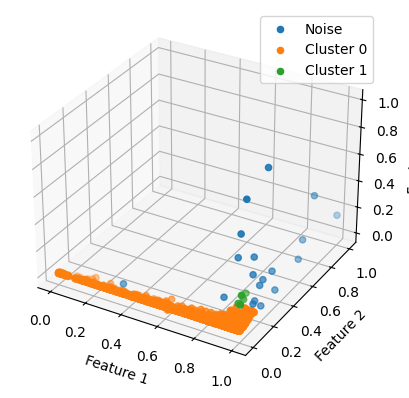

19
0.05, 10


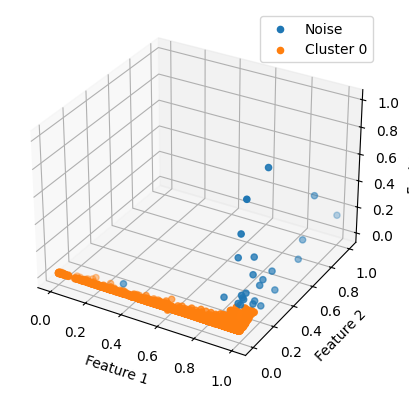

25
0.05, 15


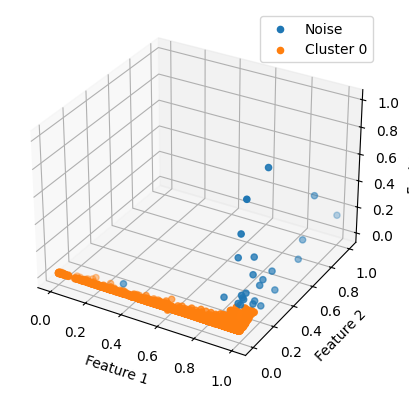

25
0.05, 20


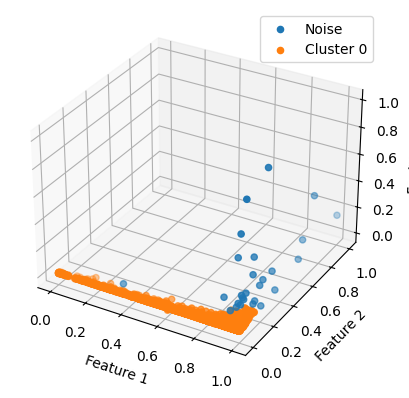

27
0.05, 25


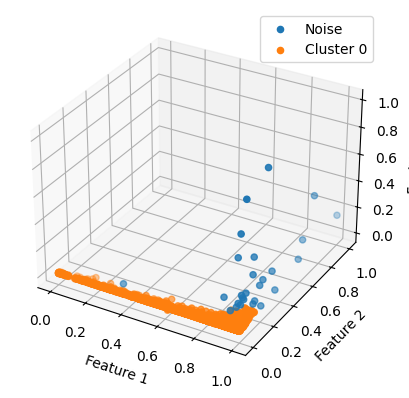

27
0.05, 30


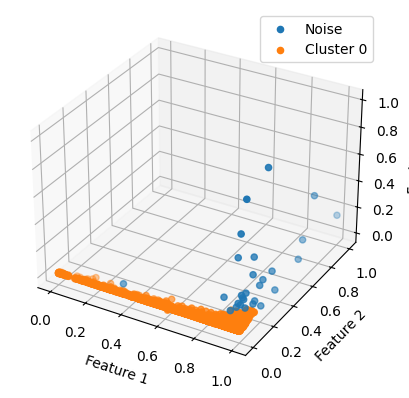

28
0.05, 35


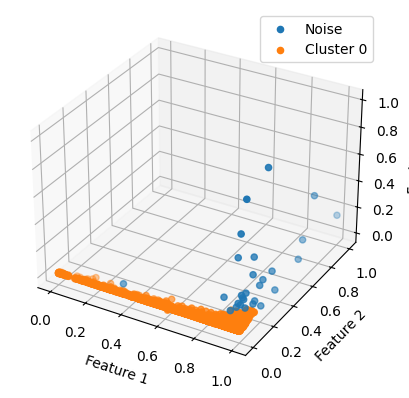

28
0.05, 40


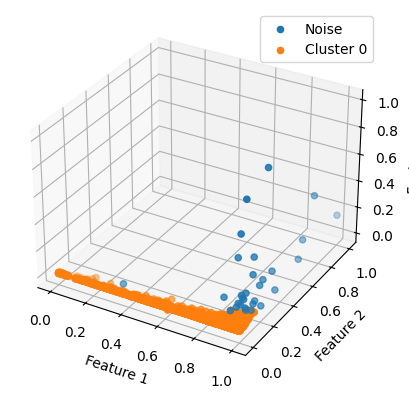

30
0.05, 45


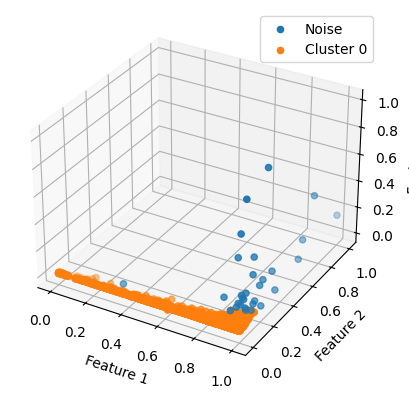

30
0.05, 50


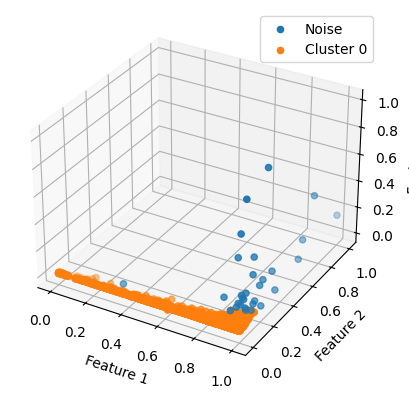

30
0.05, 55


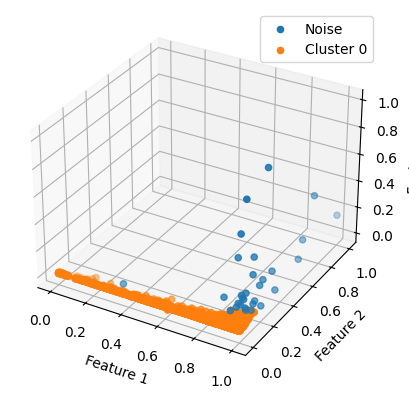

30
0.05, 60


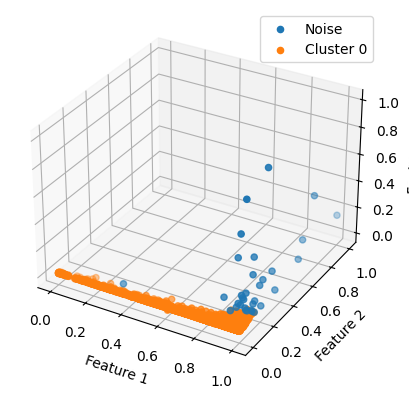

33
0.05, 65


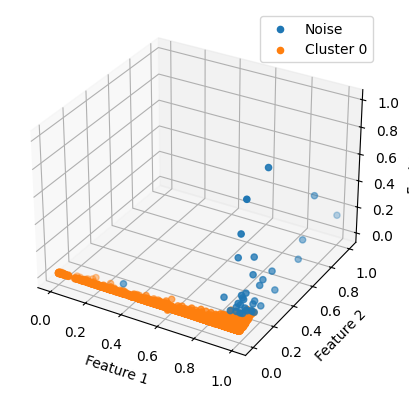

36
0.05, 70


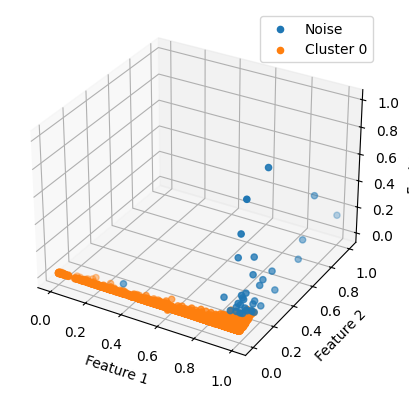

36
0.05, 75


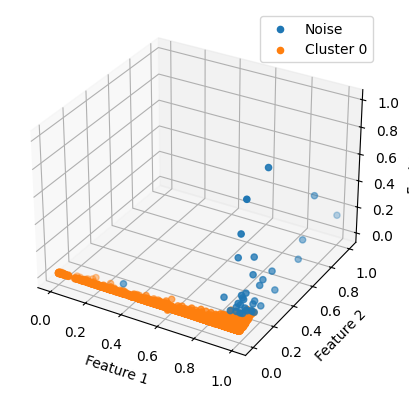

36
0.05, 80


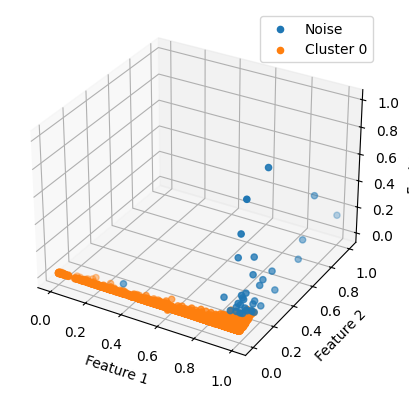

36
0.05, 85


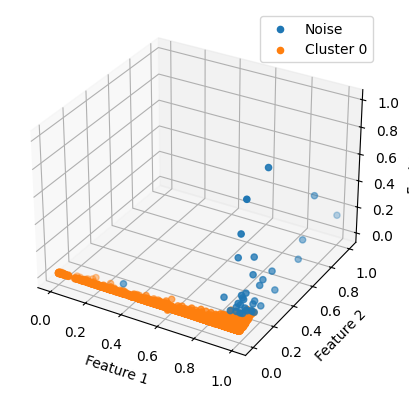

36
0.05, 90


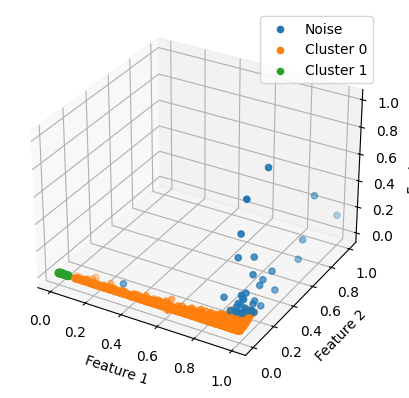

37
0.05, 95


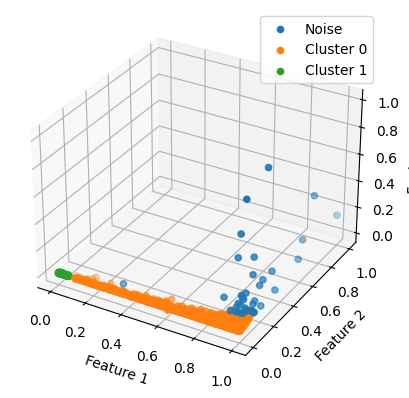

39
0.05, 100


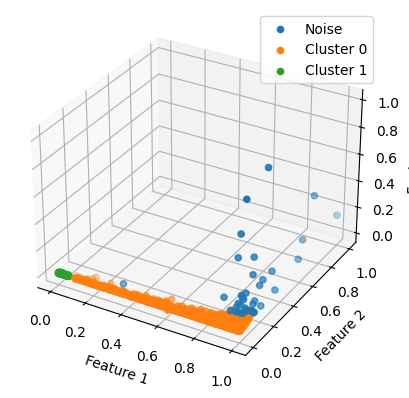

39
0.1, 5


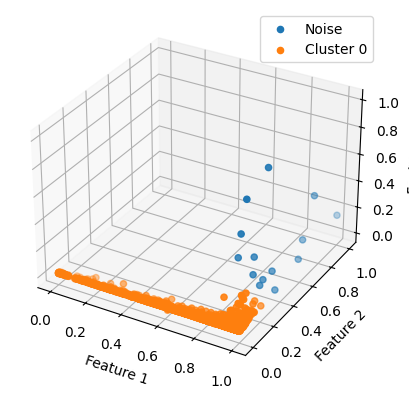

14
0.1, 10


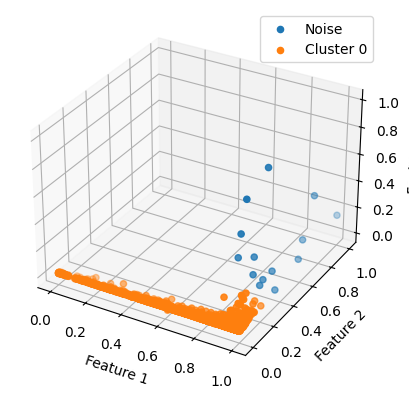

14
0.1, 15


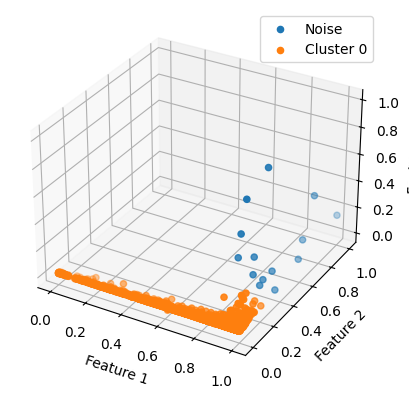

14
0.1, 20


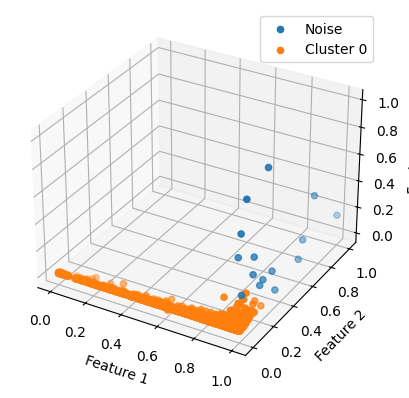

15
0.1, 25


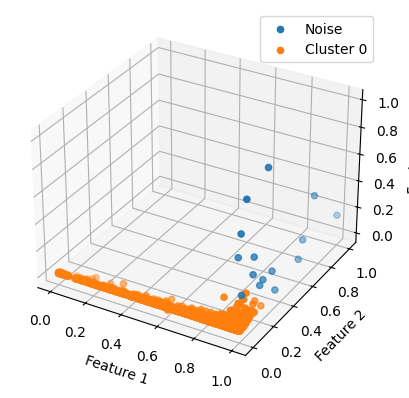

15
0.1, 30


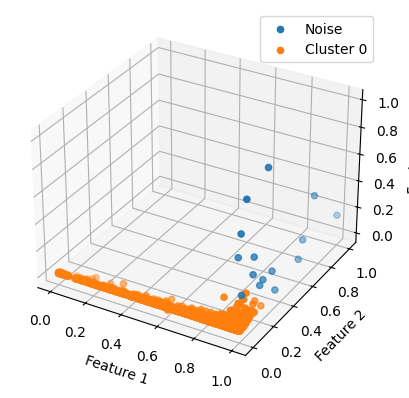

15
0.1, 35


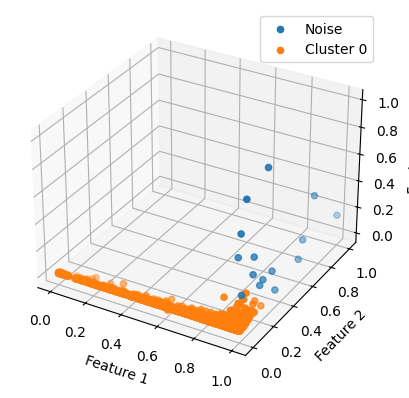

15
0.1, 40


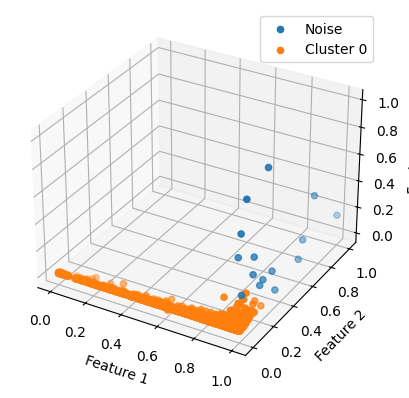

15
0.1, 45


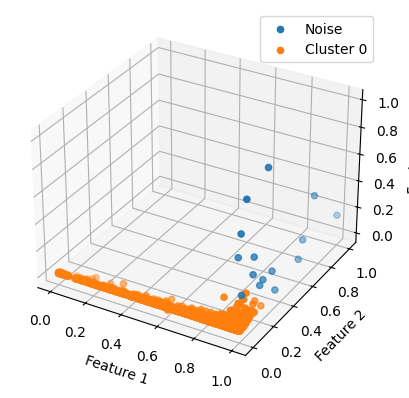

15
0.1, 50


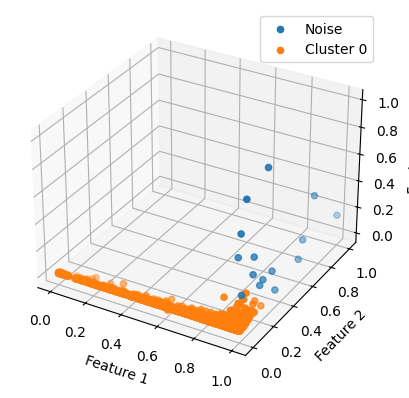

15
0.1, 55


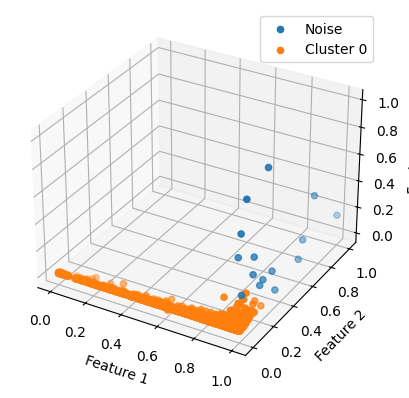

15
0.1, 60


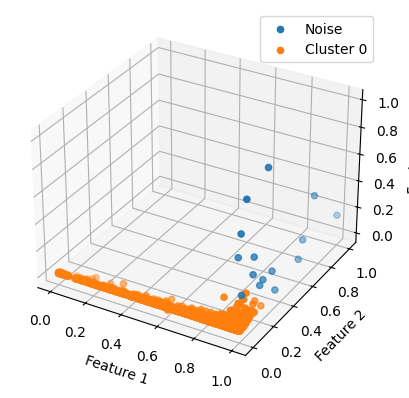

15
0.1, 65


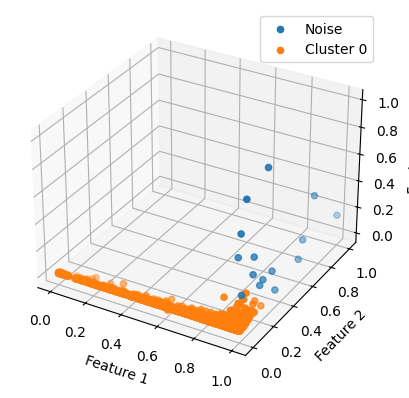

15
0.1, 70


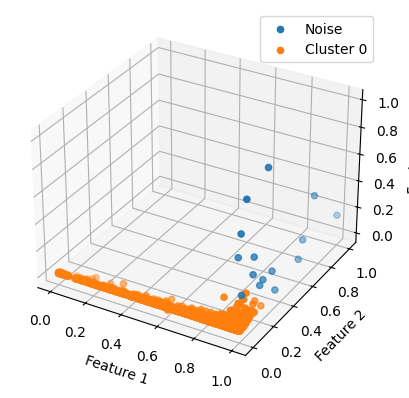

15
0.1, 75


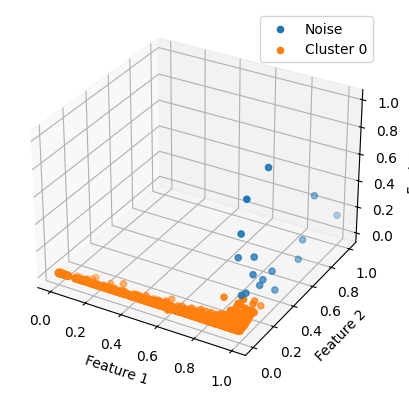

16
0.1, 80


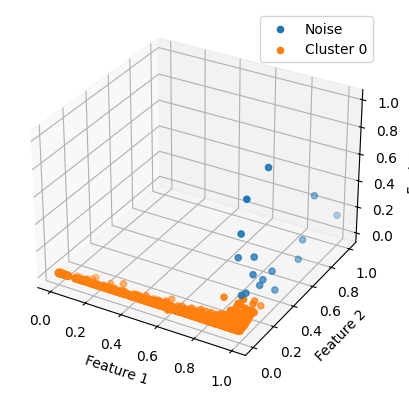

16
0.1, 85


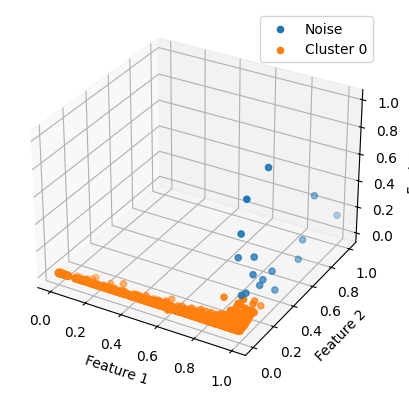

16
0.1, 90


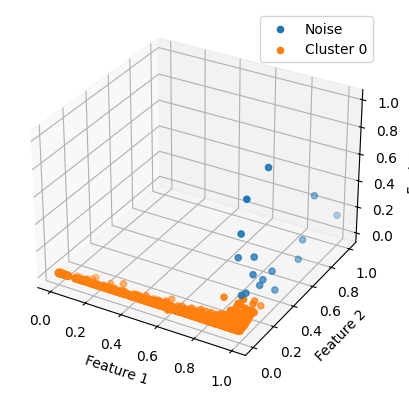

16
0.1, 95


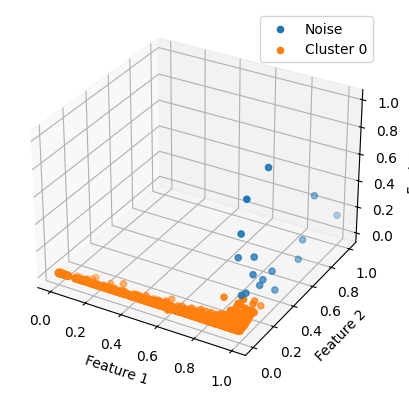

16
0.1, 100


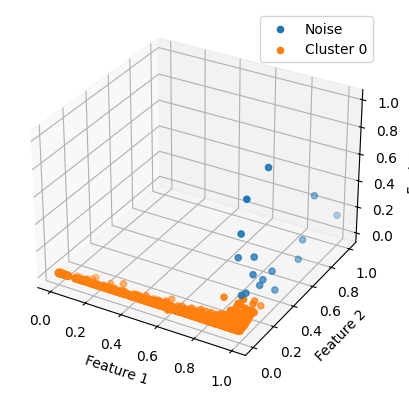

16
0.2, 5


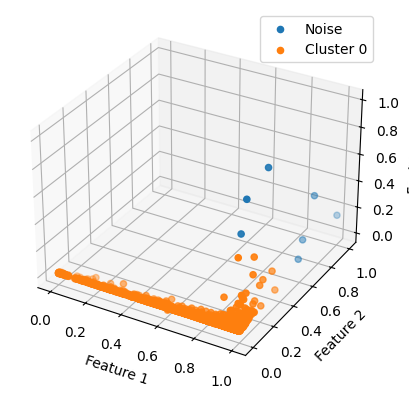

7
0.2, 10


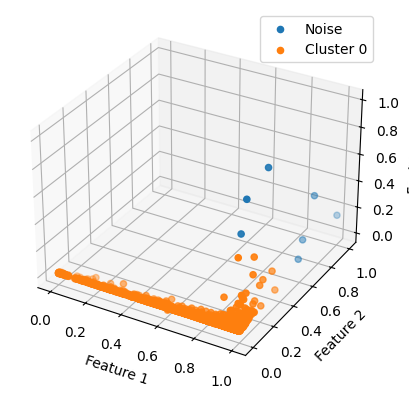

7
0.2, 15


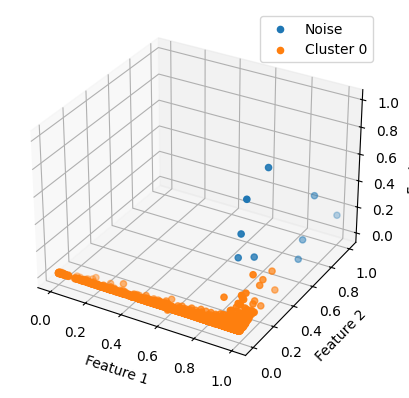

9
0.2, 20


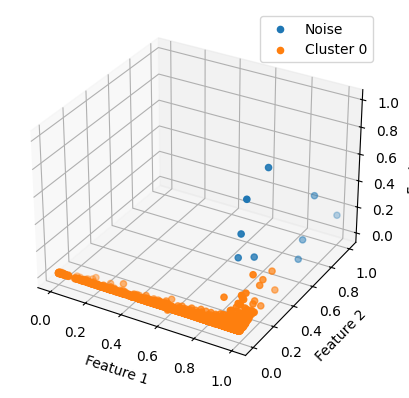

9
0.2, 25


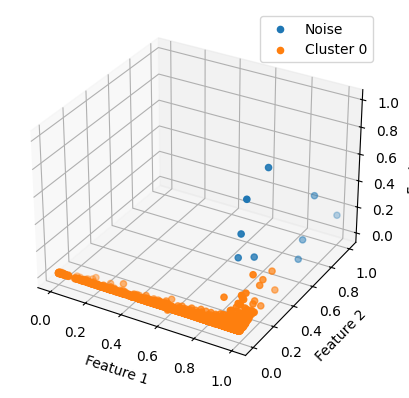

9
0.2, 30


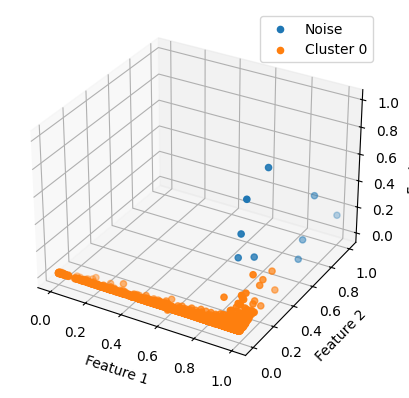

9
0.2, 35


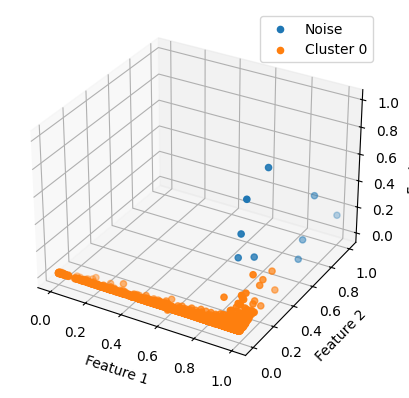

9
0.2, 40


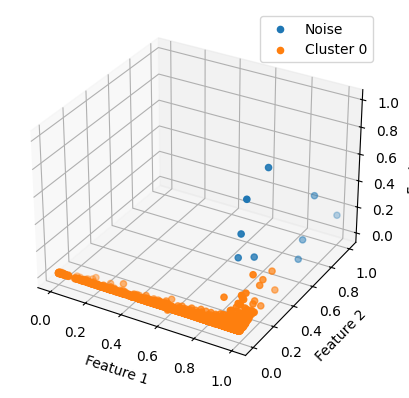

9
0.2, 45


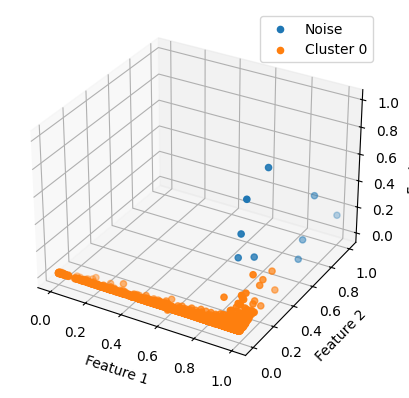

9
0.2, 50


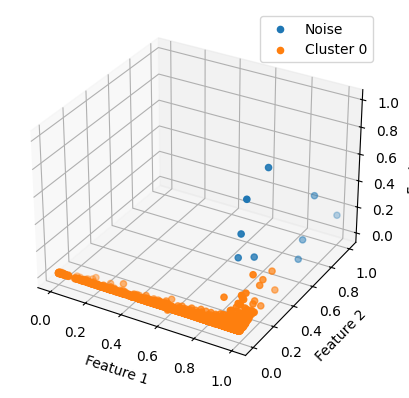

9
0.2, 55


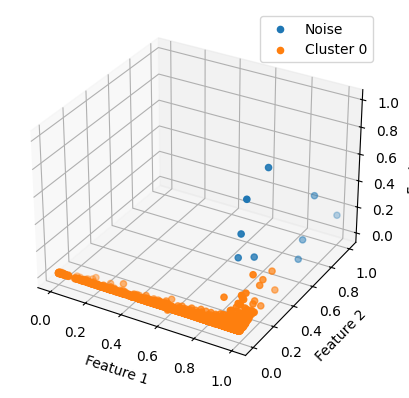

9
0.2, 60


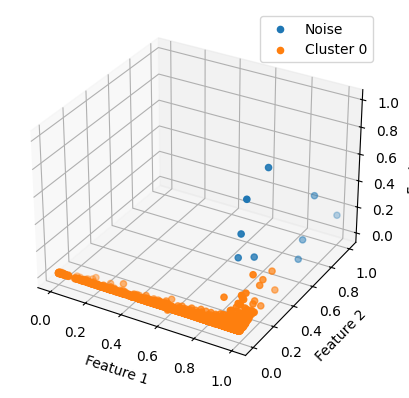

9
0.2, 65


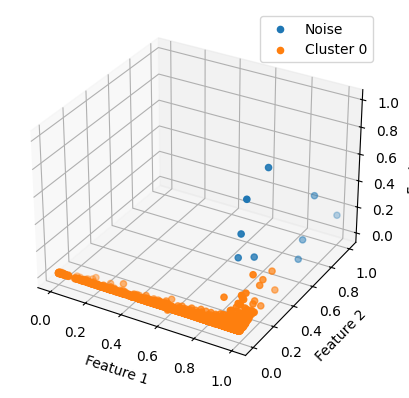

9
0.2, 70


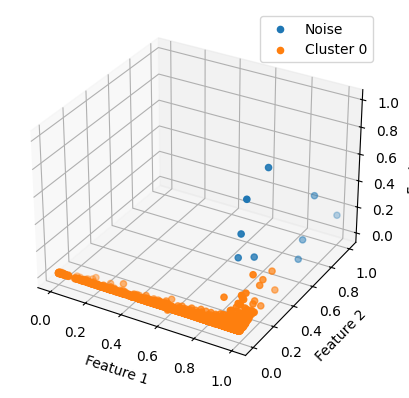

9
0.2, 75


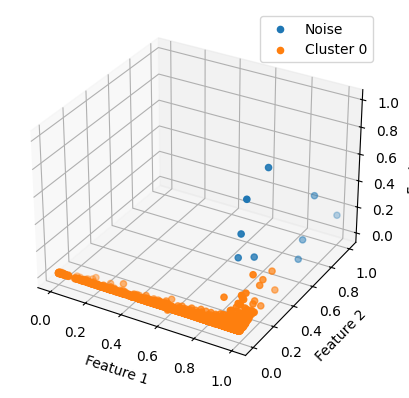

9
0.2, 80


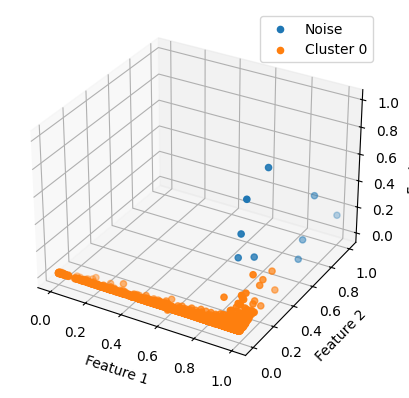

9
0.2, 85


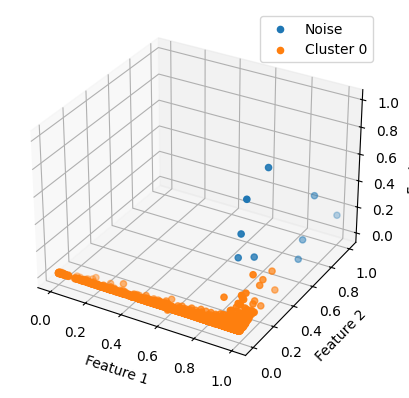

9
0.2, 90


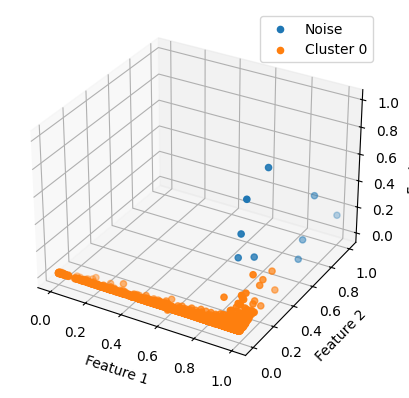

9
0.2, 95


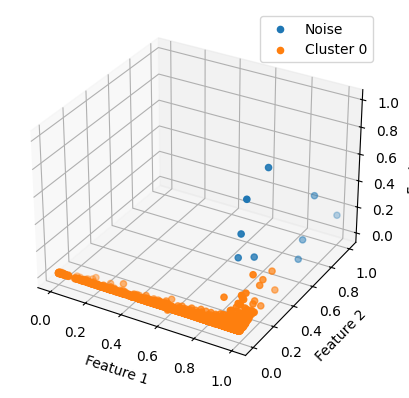

9
0.2, 100


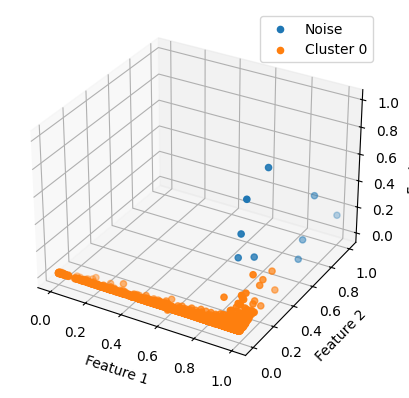

9
0.3, 5


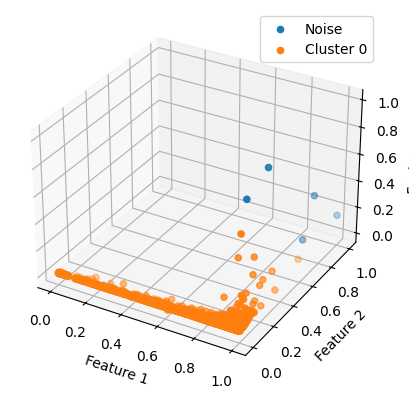

5
0.3, 10


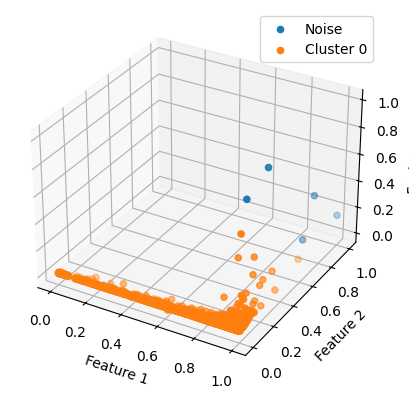

5
0.3, 15


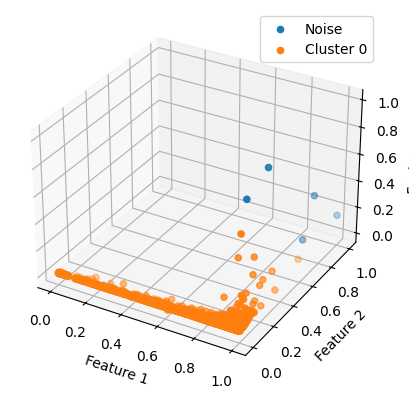

5
0.3, 20


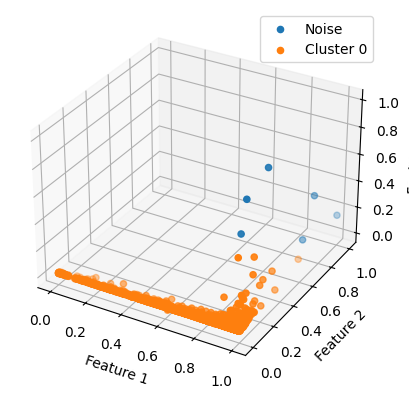

6
0.3, 25


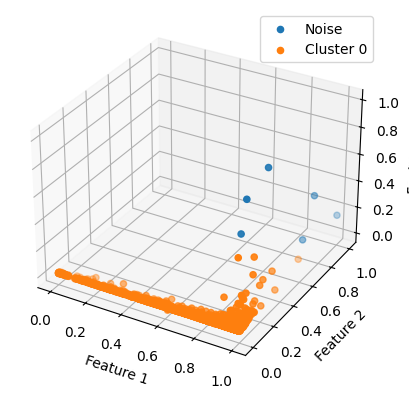

6
0.3, 30


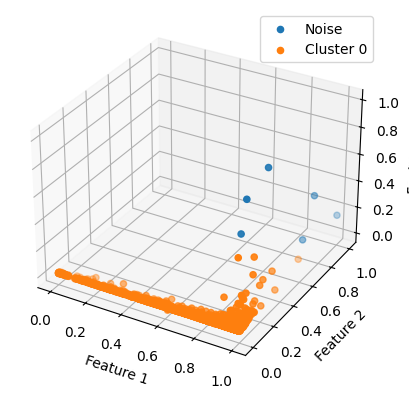

6
0.3, 35


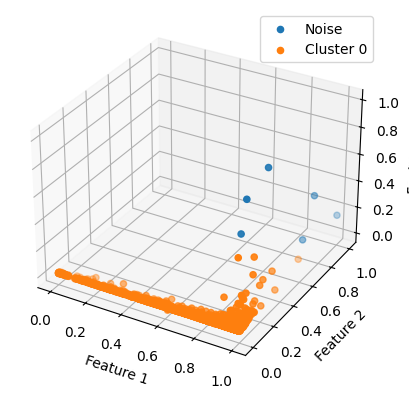

6
0.3, 40


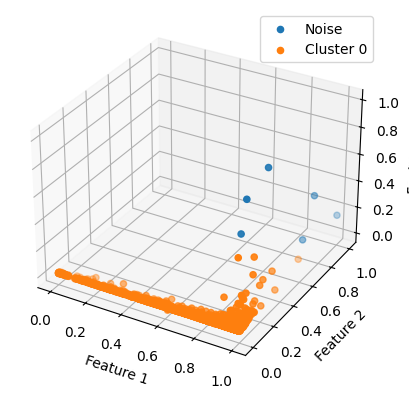

6
0.3, 45


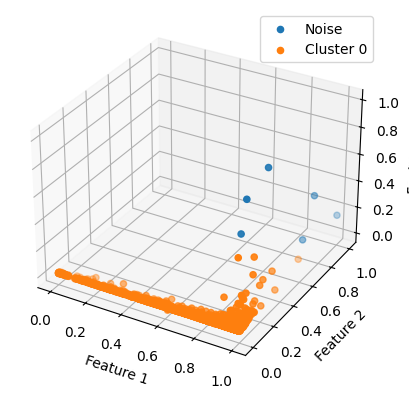

6
0.3, 50


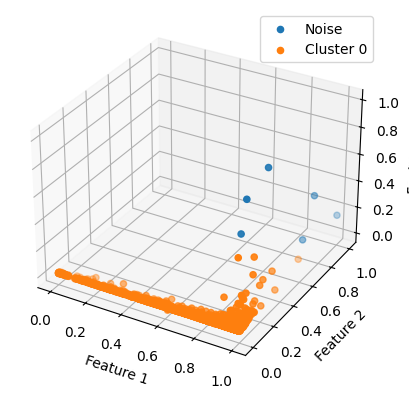

6
0.3, 55


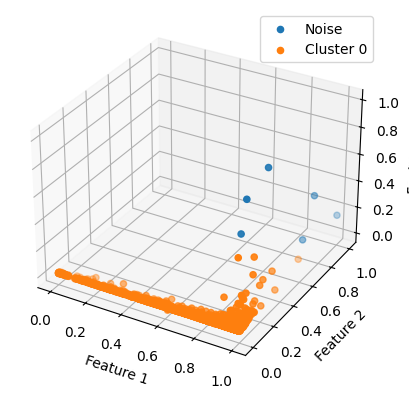

6
0.3, 60


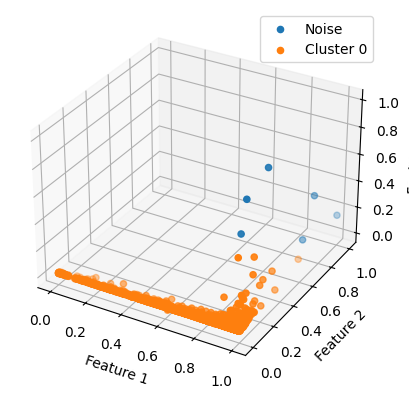

6
0.3, 65


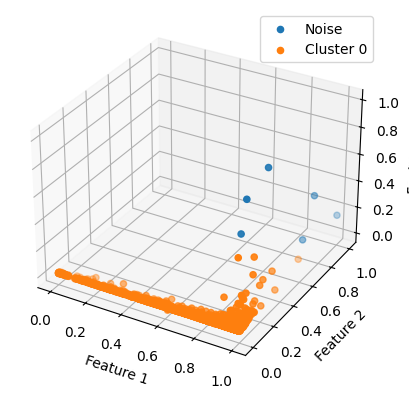

6
0.3, 70


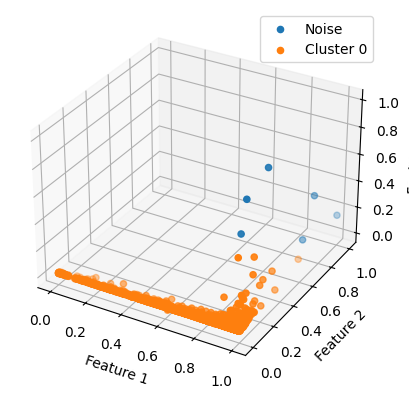

6
0.3, 75


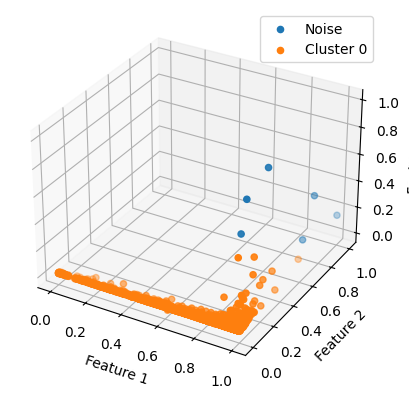

6
0.3, 80


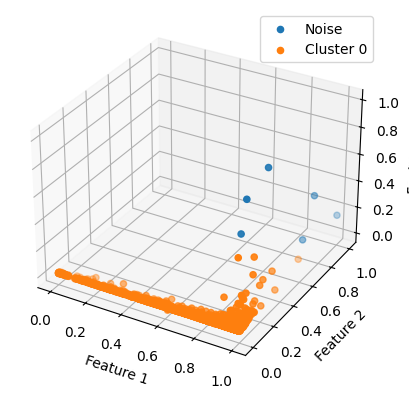

6
0.3, 85


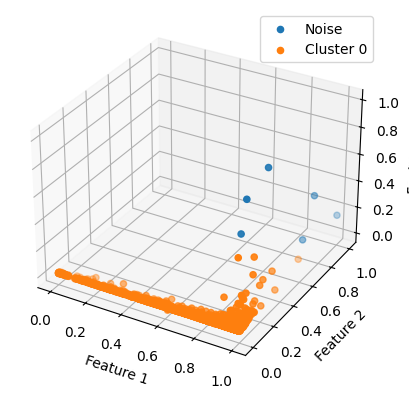

6
0.3, 90


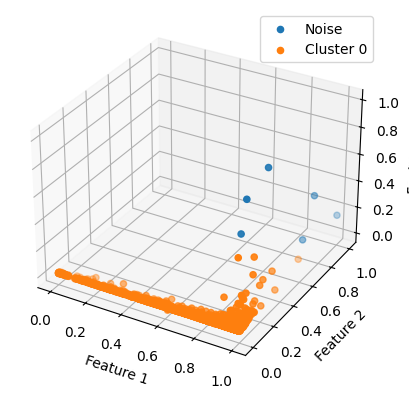

6
0.3, 95


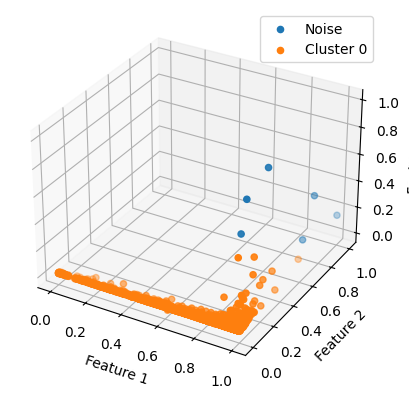

6
0.3, 100


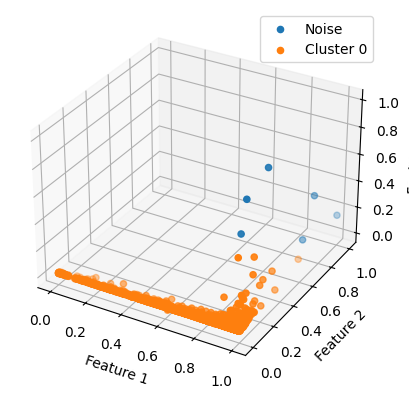

6
0.4, 5


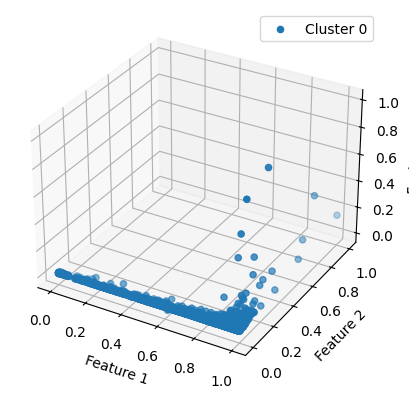

0
0.4, 10


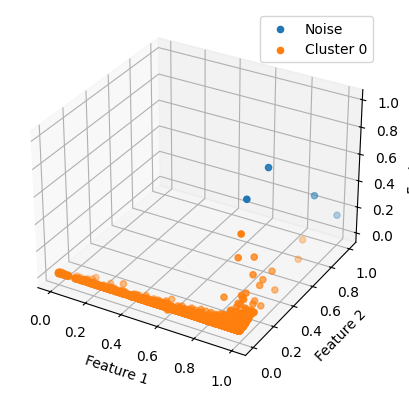

4
0.4, 15


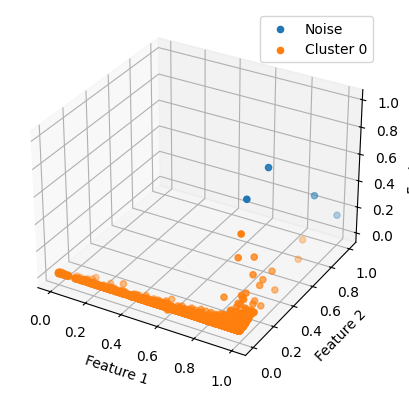

4
0.4, 20


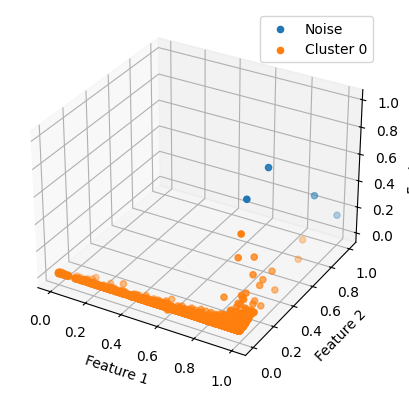

4
0.4, 25


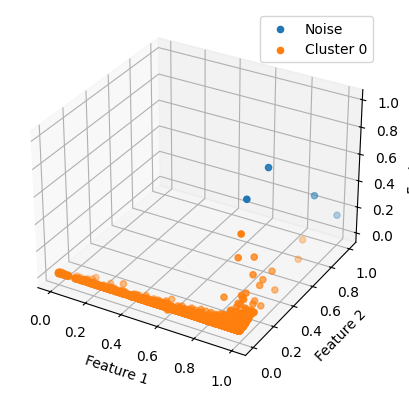

4
0.4, 30


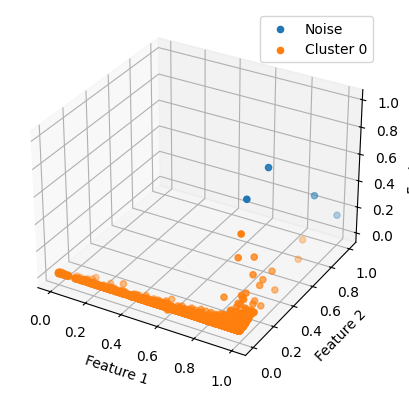

4
0.4, 35


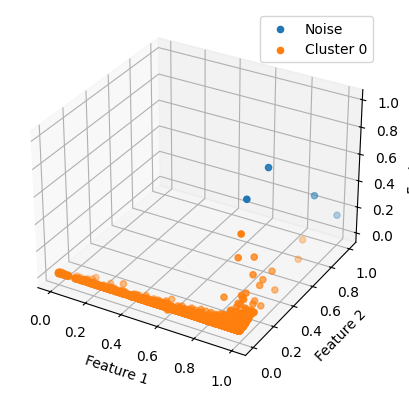

4
0.4, 40


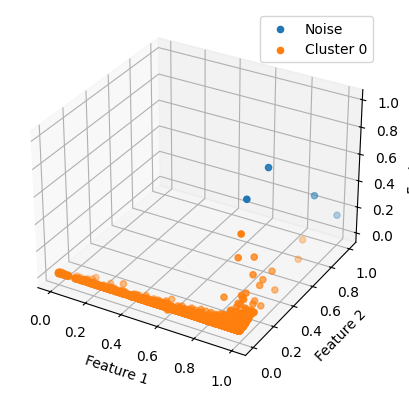

4
0.4, 45


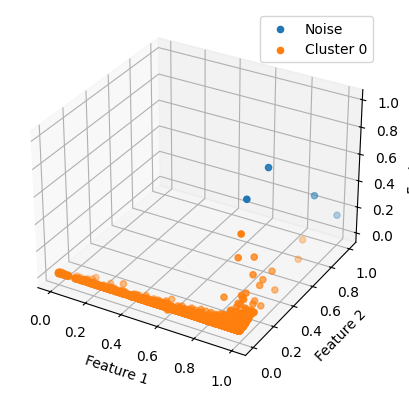

4
0.4, 50


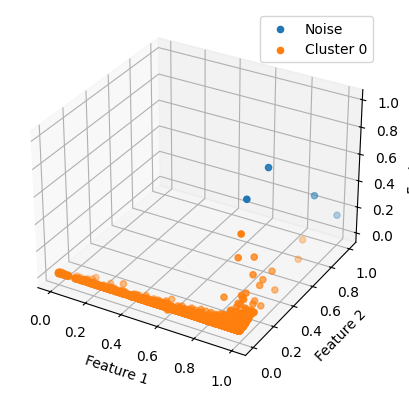

4
0.4, 55


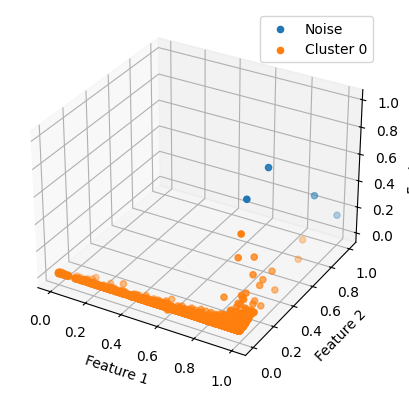

4
0.4, 60


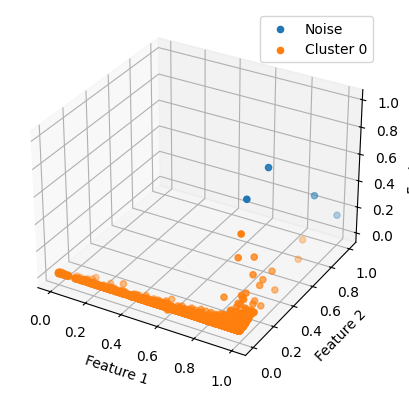

4
0.4, 65


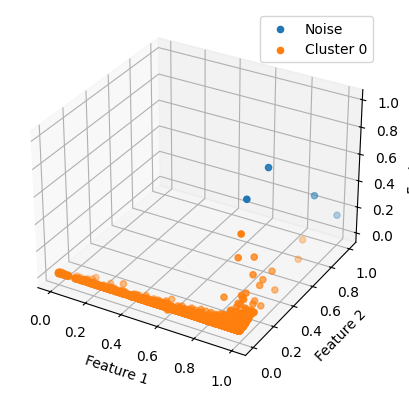

4
0.4, 70


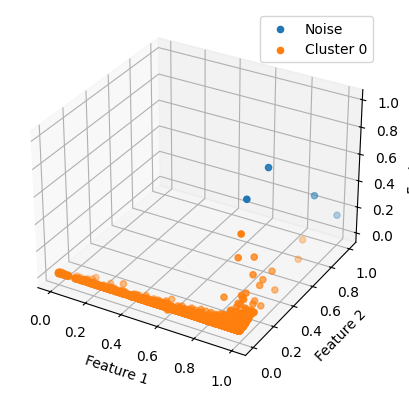

4
0.4, 75


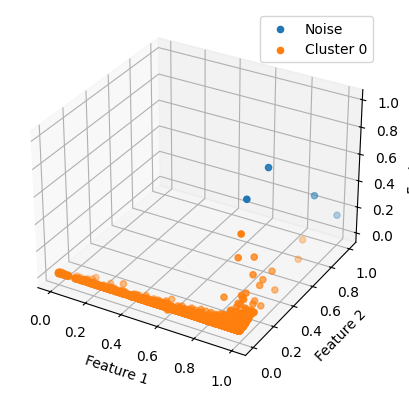

4
0.4, 80


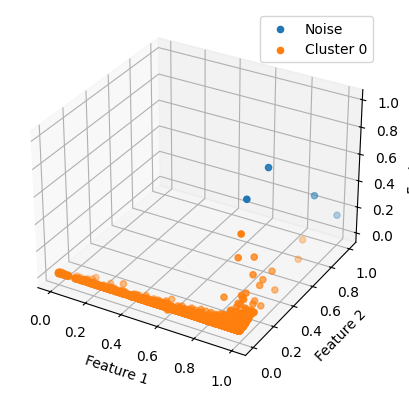

4
0.4, 85


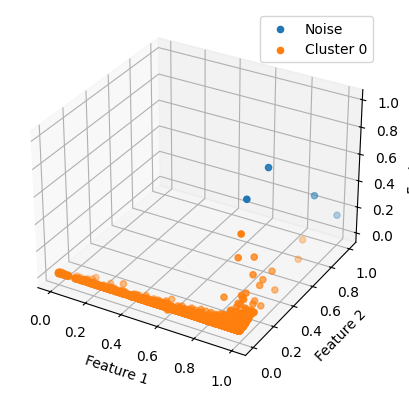

4
0.4, 90


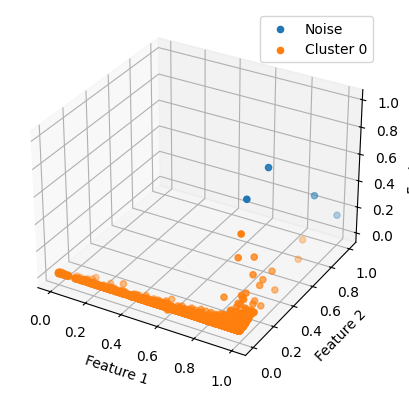

4
0.4, 95


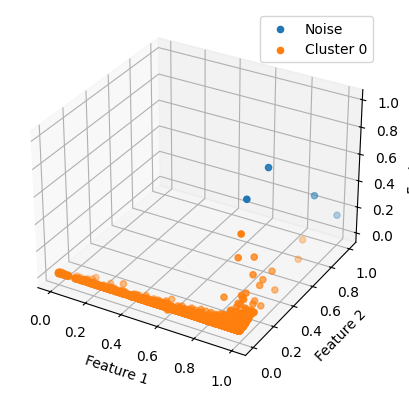

4
0.4, 100


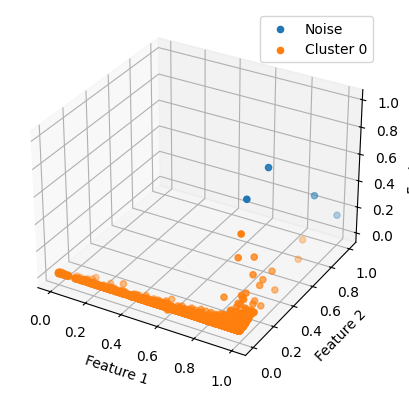

4
0.5, 5


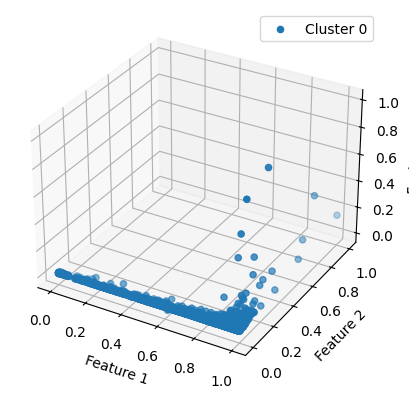

0
0.5, 10


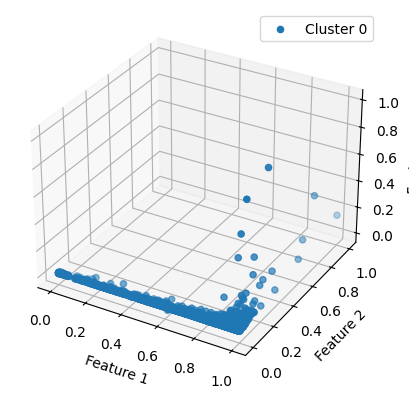

0
0.5, 15


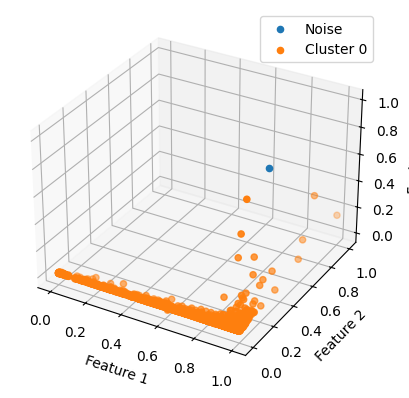

1
0.5, 20


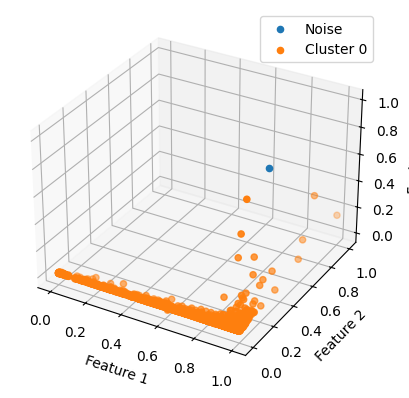

1
0.5, 25


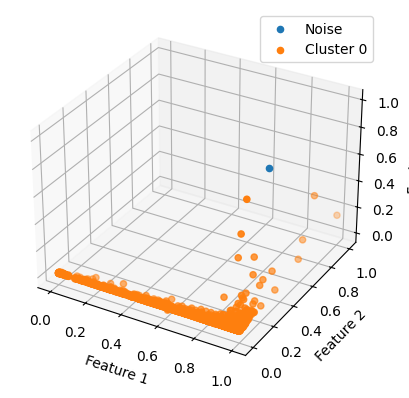

1
0.5, 30


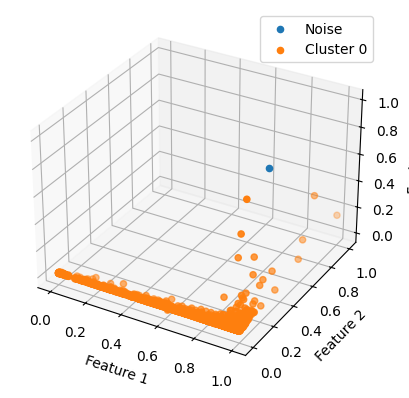

1
0.5, 35


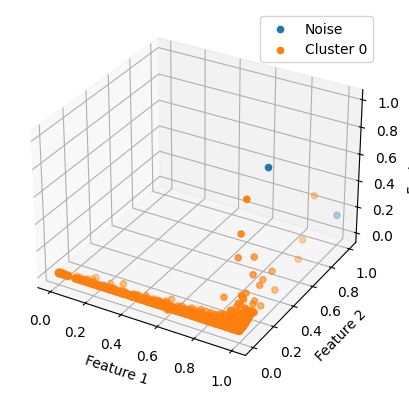

2
0.5, 40


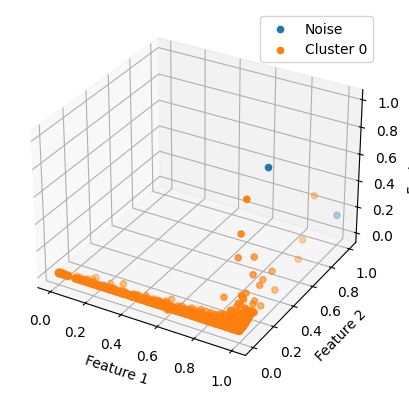

2
0.5, 45


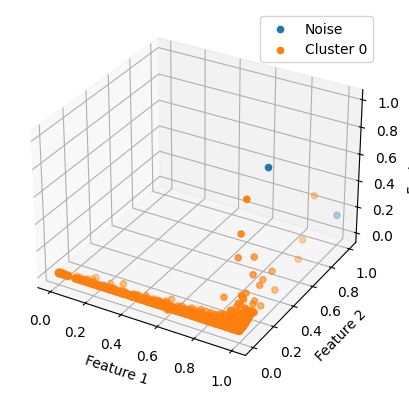

2
0.5, 50


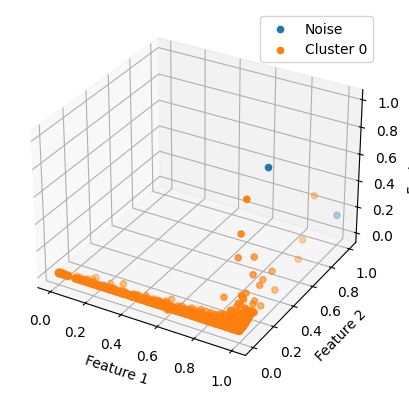

2
0.5, 55


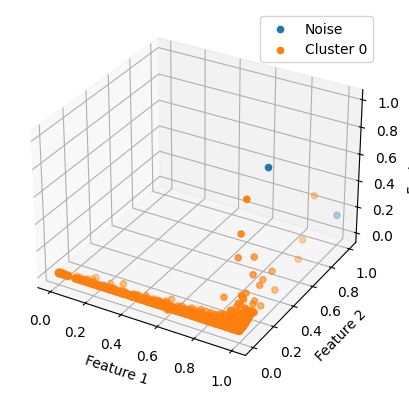

2
0.5, 60


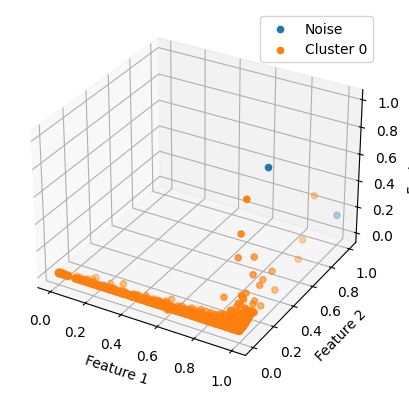

2
0.5, 65


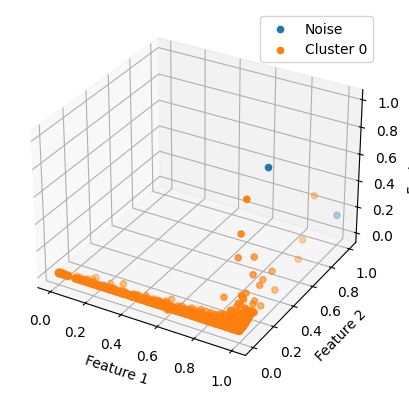

2
0.5, 70


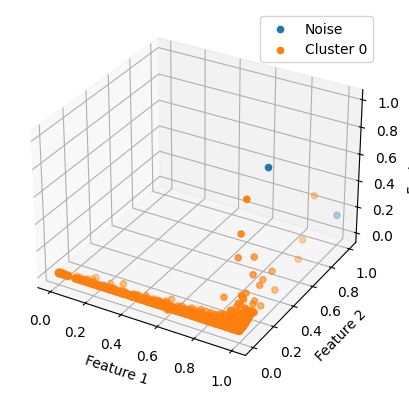

2
0.5, 75


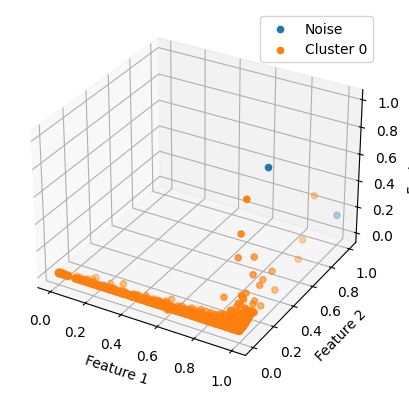

2
0.5, 80


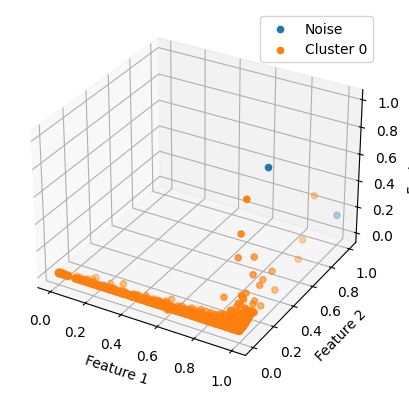

2
0.5, 85


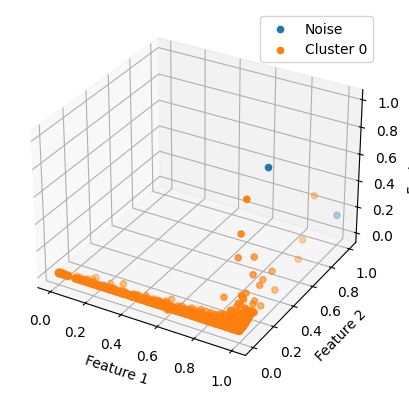

2
0.5, 90


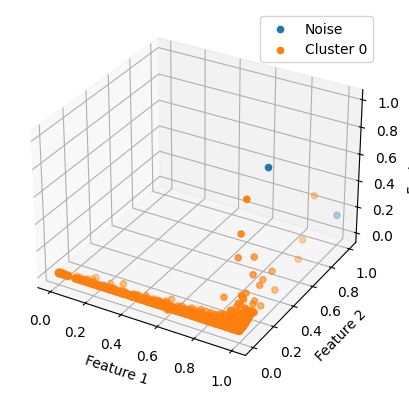

2
0.5, 95


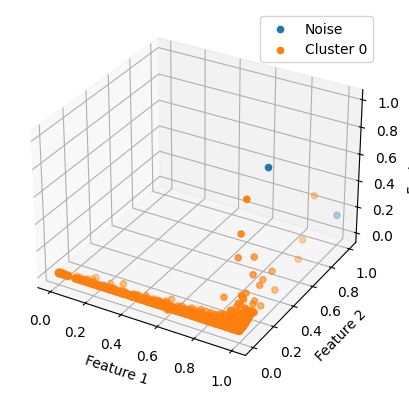

2
0.5, 100


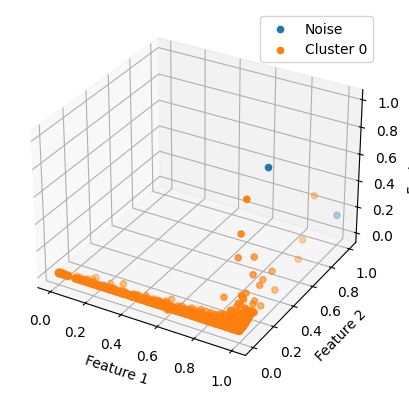

2


In [43]:
from sklearn.cluster import DBSCAN


eps_values = [0.01, 0.02, 0.03, 0.04, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5]
min_samples_list = [5*n for n in list(range(1, 21))]
rfm_numeric = rfm_score[['LastPurchaseSeconds', 'NumberPurchases', 'MoneySpent']]
scores = {(eps,min_samples):0 for eps in eps_values for min_samples in min_samples_list}
for eps in eps_values:
    for min_samples in min_samples_list:
        model = DBSCAN(eps=eps, min_samples = min_samples)
        model.fit(rfm_numeric)
        labels = model.labels_
        
        # Create a 3D scatter plot
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        
        # Get unique clusters
        unique_labels = np.unique(labels)
        
        # Assign colors to clusters
        print(str(eps) + ", " + str(min_samples))
        for label in unique_labels:
            # Mask for points belonging to the current cluster
            cluster_mask = (labels == label)

            # Plot the points
            ax.scatter(
                rfm_numeric.iloc[cluster_mask, 0], rfm_numeric.iloc[cluster_mask, 1], rfm_numeric.iloc[cluster_mask, 2],
                label=f'Cluster {label}' if label != -1 else 'Noise'
            )
        
        # Add labels and legend
        ax.set_xlabel('Feature 1')
        ax.set_ylabel('Feature 2')
        ax.set_zlabel('Feature 3')
        plt.legend()
        plt.show()
        
        # Count outliers (points labeled as -1)
        num_outliers = np.sum(labels == -1)
        print(num_outliers)

        # Take all non-outliers and compute the silhouette score
        rfm_numeric_labels_reset = rfm_numeric.reset_index()
        rfm_with_labels = pd.concat([rfm_numeric_labels_reset, pd.Series(labels)], axis=1)
        rfm_with_labels.columns = ['CustomerID', 'RecencyScore', 'FrequencyScore', 'MonetaryValueScore', 'Label']
        rfm_non_outliers = rfm_with_labels.loc[rfm_with_labels['Label'] != -1]
        label_series = rfm_non_outliers['Label']
        rfm_non_outliers = rfm_non_outliers.drop(columns='Label')
        if label_series.nunique() > 1:
            scores[(eps, min_samples)] = silhouette_score(rfm_non_outliers, label_series)

In [44]:
scores

{(0.01, 5): np.float64(-0.2515454276899435),
 (0.01, 10): np.float64(-0.05014514881914957),
 (0.01, 15): np.float64(-0.04997967891733654),
 (0.01, 20): np.float64(-0.061266201989249536),
 (0.01, 25): np.float64(-0.10584397176257222),
 (0.01, 30): np.float64(-0.12435733314836608),
 (0.01, 35): np.float64(-0.13409312505085896),
 (0.01, 40): np.float64(-0.1263101756473646),
 (0.01, 45): np.float64(-0.1323764738709968),
 (0.01, 50): np.float64(-0.1231326274852835),
 (0.01, 55): 0,
 (0.01, 60): 0,
 (0.01, 65): 0,
 (0.01, 70): 0,
 (0.01, 75): 0,
 (0.01, 80): 0,
 (0.01, 85): 0,
 (0.01, 90): 0,
 (0.01, 95): 0,
 (0.01, 100): 0,
 (0.02, 5): np.float64(-0.22089440084124892),
 (0.02, 10): np.float64(0.019526528814942688),
 (0.02, 15): np.float64(0.01961410706708855),
 (0.02, 20): np.float64(0.019723020012617613),
 (0.02, 25): np.float64(0.019896334760176285),
 (0.02, 30): np.float64(0.019885101263861688),
 (0.02, 35): np.float64(0.01958182767983272),
 (0.02, 40): np.float64(0.01967516919078928),
 

It looks like 0.01 is a bit too small, but 0.02 is already too large. Let's try stuff in between.

The silhouette scores are dreadful, by the way!

0.01, 5


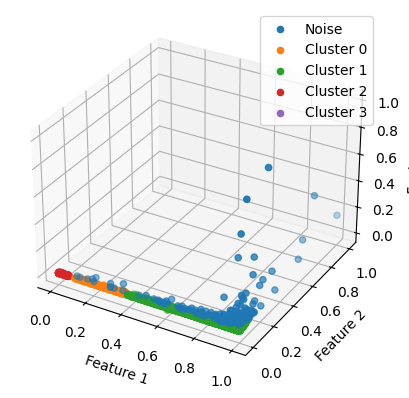

175
0.01, 6


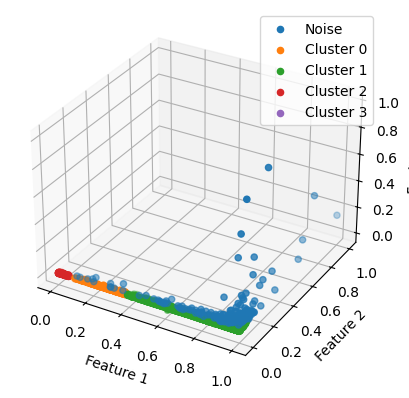

194
0.01, 7


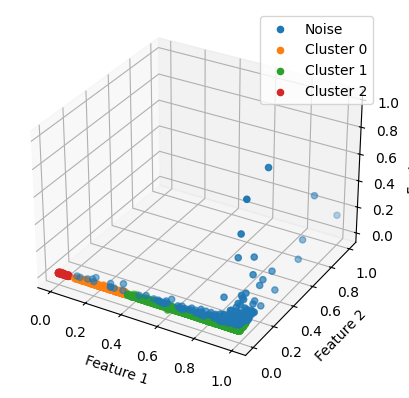

212
0.01, 8


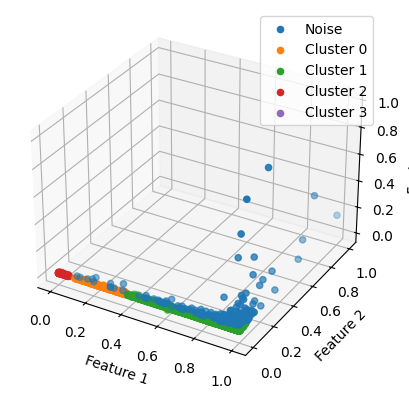

228
0.01, 9


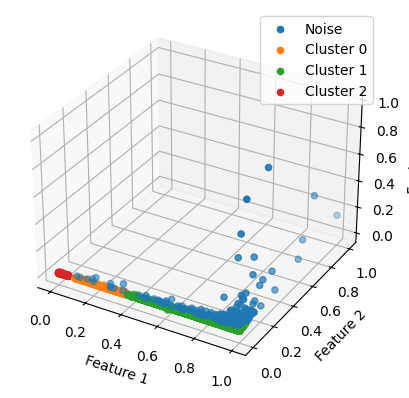

243
0.011, 5


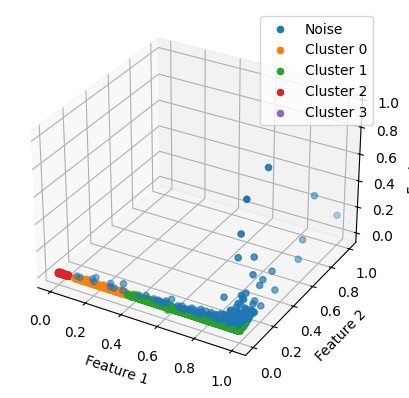

145
0.011, 6


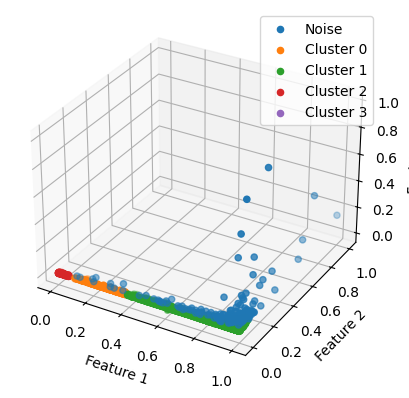

159
0.011, 7


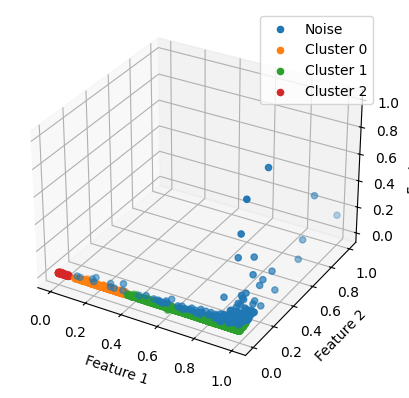

178
0.011, 8


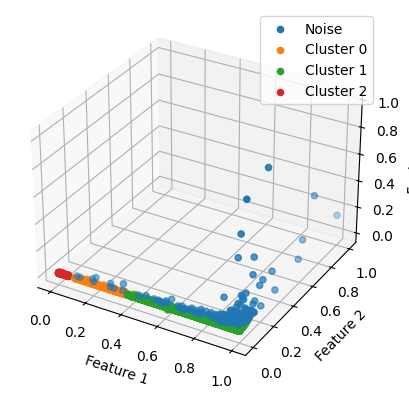

187
0.011, 9


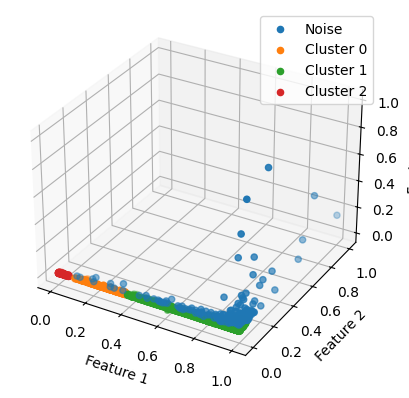

203
0.012, 5


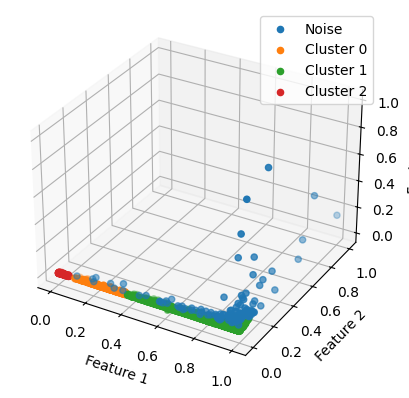

127
0.012, 6


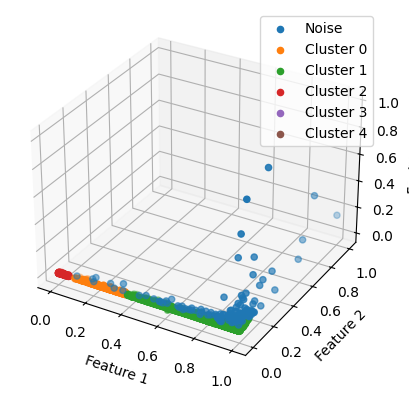

135
0.012, 7


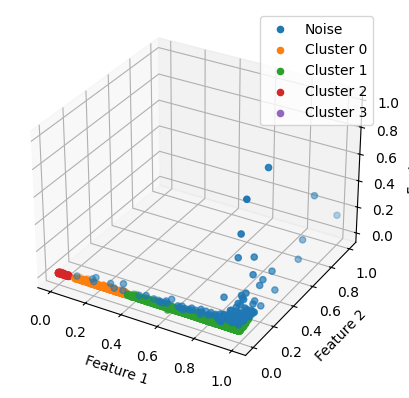

145
0.012, 8


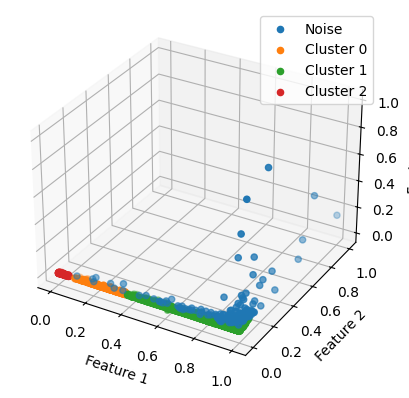

161
0.012, 9


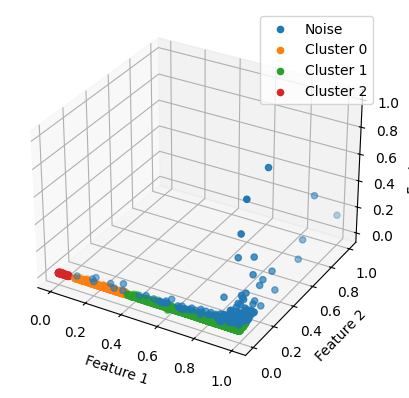

175
0.013, 5


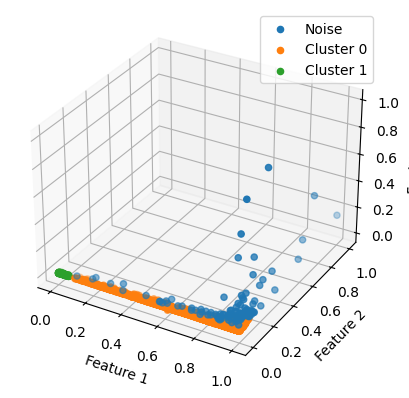

118
0.013, 6


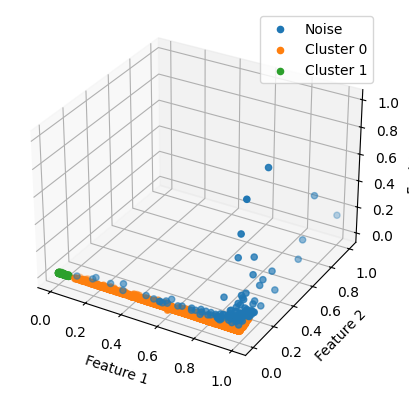

123
0.013, 7


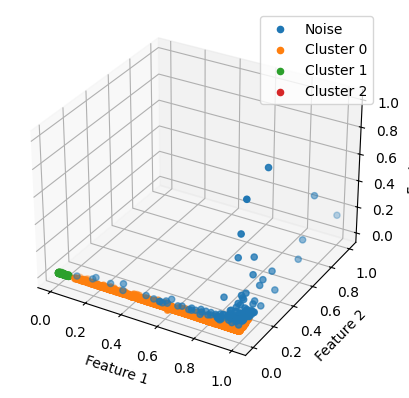

131
0.013, 8


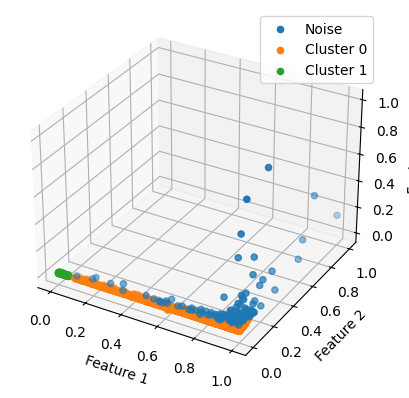

141
0.013, 9


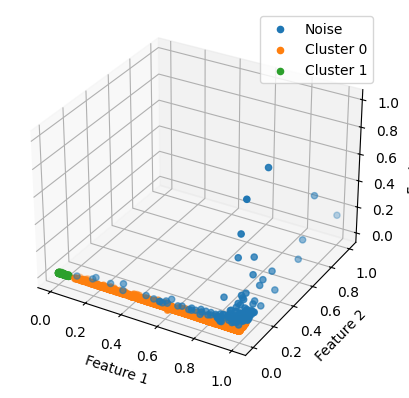

153
0.014, 5


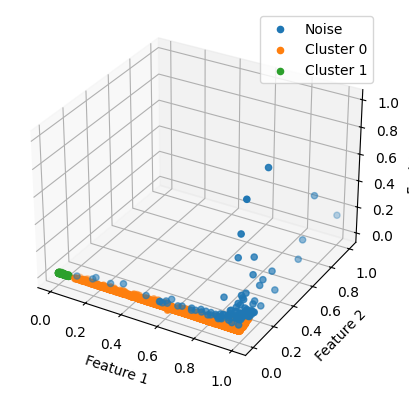

112
0.014, 6


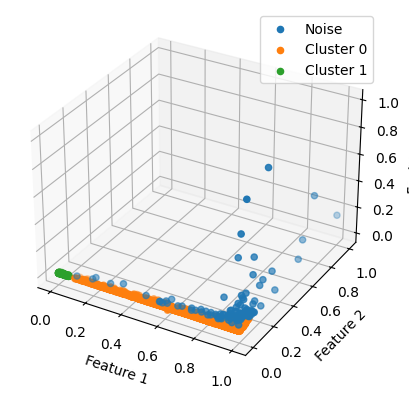

114
0.014, 7


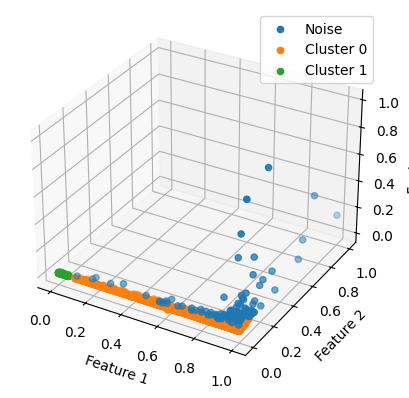

116
0.014, 8


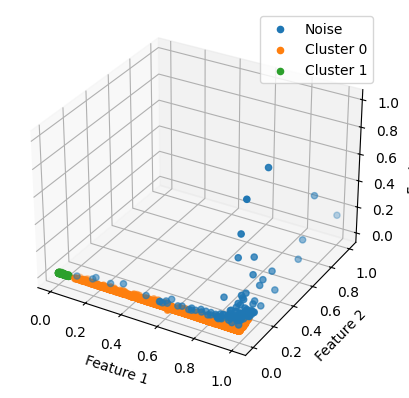

119
0.014, 9


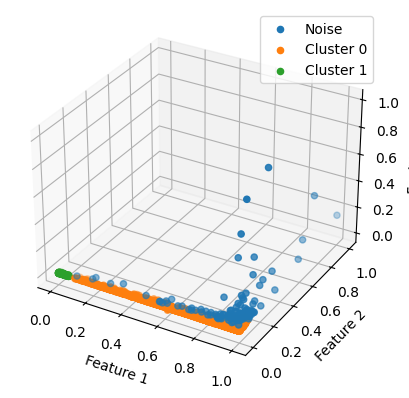

126
0.015, 5


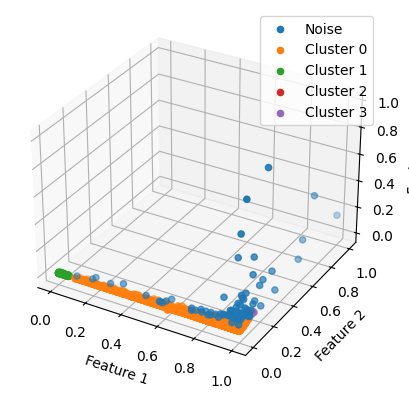

90
0.015, 6


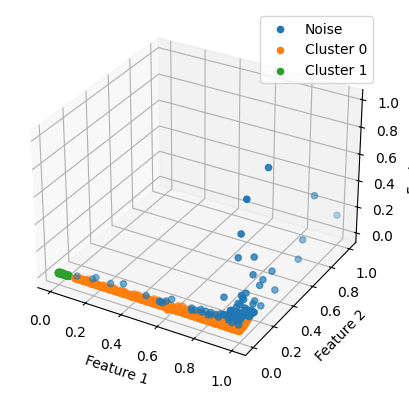

103
0.015, 7


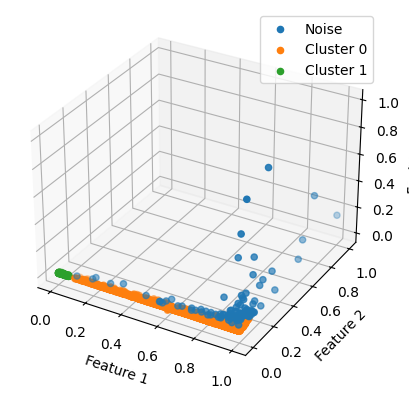

108
0.015, 8


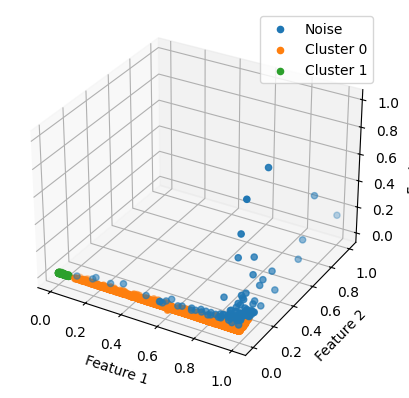

109
0.015, 9


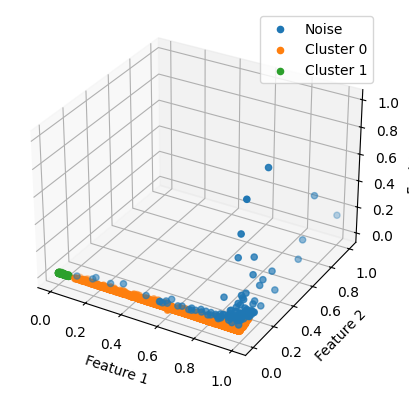

117
0.016, 5


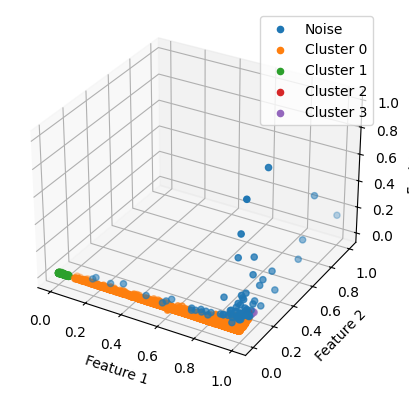

80
0.016, 6


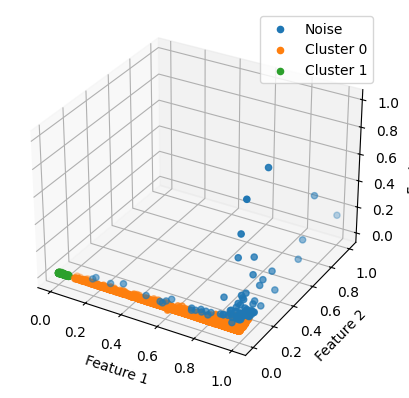

92
0.016, 7


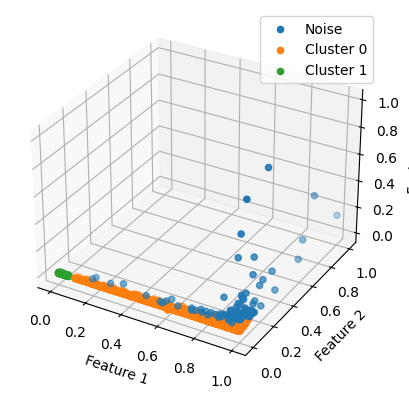

98
0.016, 8


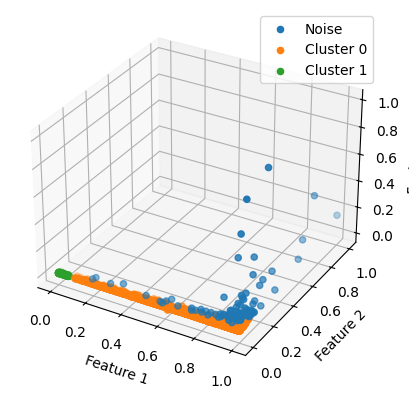

101
0.016, 9


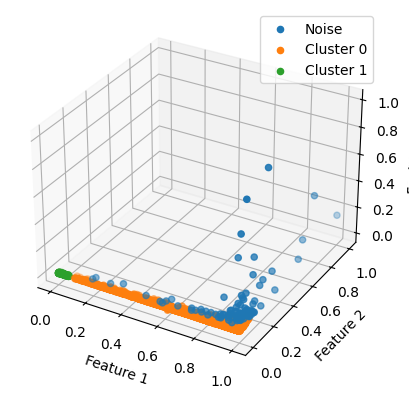

104
0.017, 5


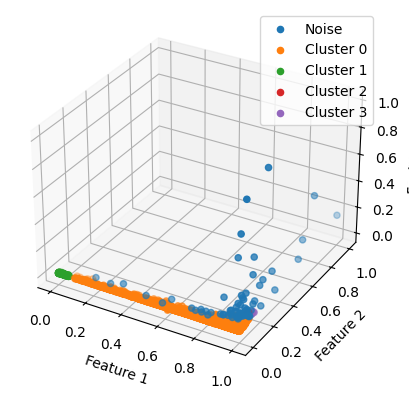

72
0.017, 6


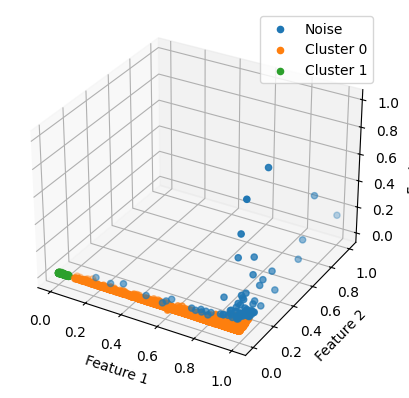

84
0.017, 7


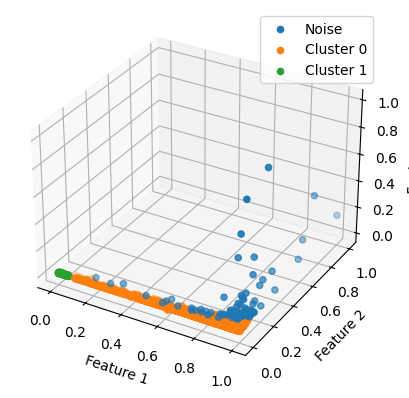

87
0.017, 8


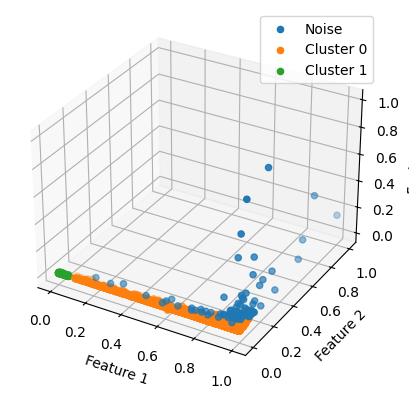

92
0.017, 9


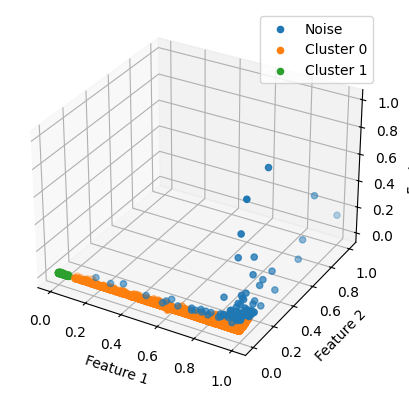

95
0.018, 5


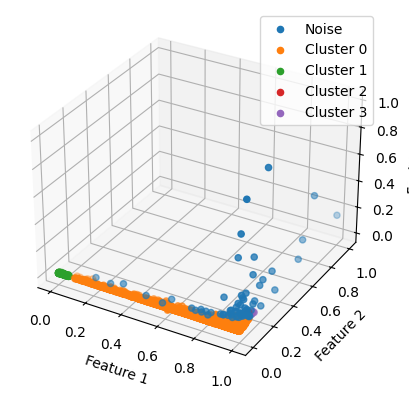

68
0.018, 6


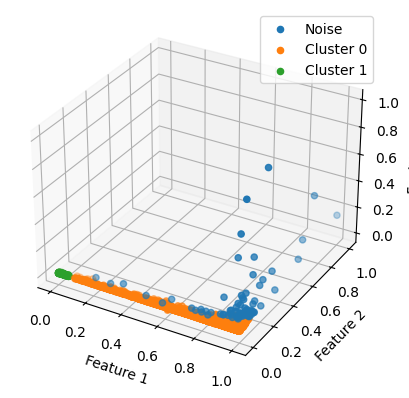

79
0.018, 7


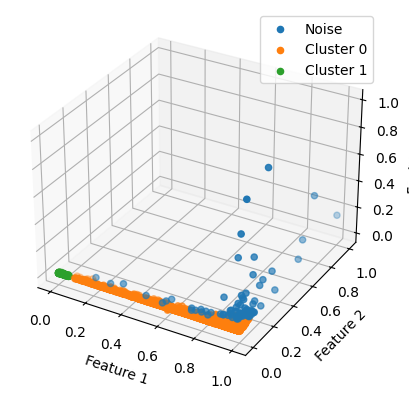

83
0.018, 8


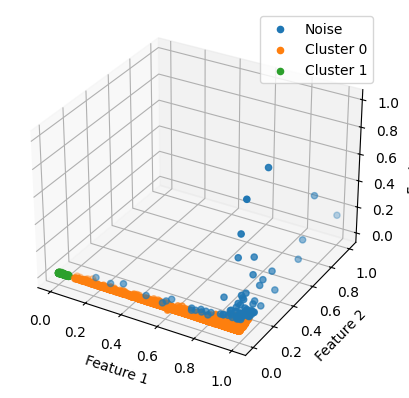

85
0.018, 9


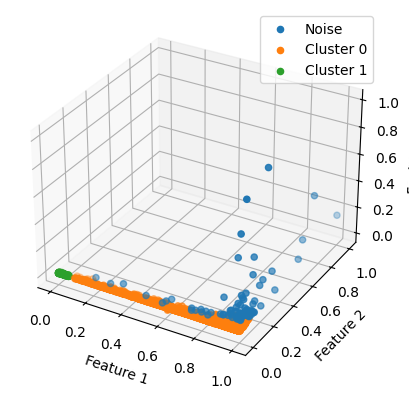

87
0.019, 5


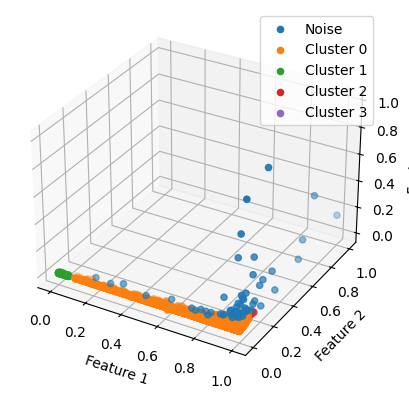

59
0.019, 6


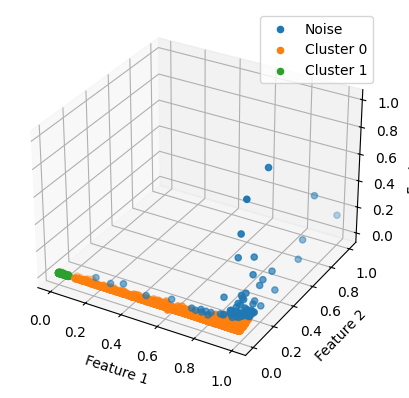

70
0.019, 7


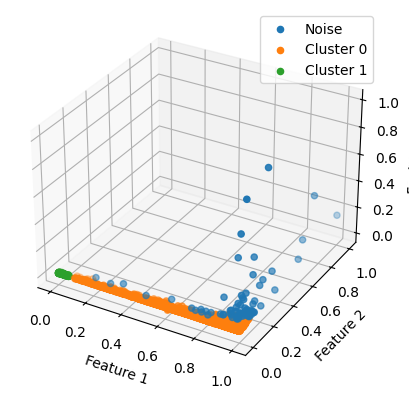

72
0.019, 8


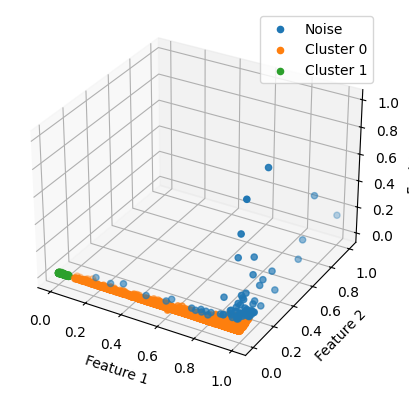

76
0.019, 9


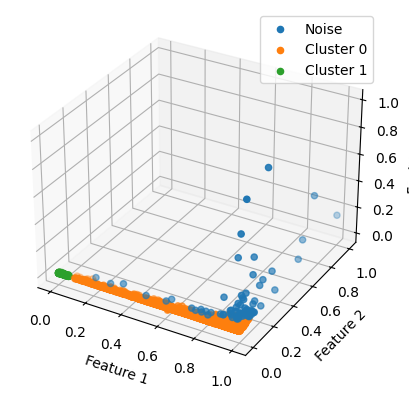

77


In [45]:
eps_values = [0.01, 0.011, 0.012, 0.013, 0.014, 0.015, 0.016, 0.017, 0.018, 0.019]
min_samples_list = [5, 6, 7, 8, 9]
rfm_numeric = rfm_score[['LastPurchaseSeconds', 'NumberPurchases', 'MoneySpent']]
scores_2 = {(eps,min_samples):0 for eps in eps_values for min_samples in min_samples_list}
for eps in eps_values:
    for min_samples in min_samples_list:
        model = DBSCAN(eps=eps, min_samples = min_samples)
        model.fit(rfm_numeric)
        labels = model.labels_
        
        # Create a 3D scatter plot
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        
        # Get unique clusters
        unique_labels = np.unique(labels)
        
        # Assign colors to clusters
        print(str(eps) + ", " + str(min_samples))
        for label in unique_labels:
            # Mask for points belonging to the current cluster
            cluster_mask = (labels == label)

            # Plot the points
            ax.scatter(
                rfm_numeric.iloc[cluster_mask, 0], rfm_numeric.iloc[cluster_mask, 1], rfm_numeric.iloc[cluster_mask, 2],
                label=f'Cluster {label}' if label != -1 else 'Noise'
            )
        
        # Add labels and legend
        ax.set_xlabel('Feature 1')
        ax.set_ylabel('Feature 2')
        ax.set_zlabel('Feature 3')
        plt.legend()
        plt.show()
        
        # Count outliers (points labeled as -1)
        num_outliers = np.sum(labels == -1)
        print(num_outliers)

        # Take all non-outliers and compute the silhouette score
        rfm_numeric_labels_reset = rfm_numeric.reset_index()
        rfm_with_labels = pd.concat([rfm_numeric_labels_reset, pd.Series(labels)], axis=1)
        rfm_with_labels.columns = ['CustomerID', 'RecencyScore', 'FrequencyScore', 'MonetaryValueScore', 'Label']
        rfm_non_outliers = rfm_with_labels.loc[rfm_with_labels['Label'] != -1]
        label_series = rfm_non_outliers['Label']
        rfm_non_outliers = rfm_non_outliers.drop(columns='Label')
        if label_series.nunique() > 1:
            scores_2[(eps, min_samples)] = silhouette_score(rfm_non_outliers, label_series)

In [46]:
scores_2

{(0.01, 5): np.float64(-0.2515454276899435),
 (0.01, 6): np.float64(-0.2231746368496077),
 (0.01, 7): np.float64(-0.05061679068237653),
 (0.01, 8): np.float64(-0.17640195514825524),
 (0.01, 9): np.float64(-0.05015913224125258),
 (0.011, 5): np.float64(-0.1785421718415792),
 (0.011, 6): np.float64(-0.23770652860294536),
 (0.011, 7): np.float64(-0.05030148081784268),
 (0.011, 8): np.float64(-0.050203682040099146),
 (0.011, 9): np.float64(-0.05001151963200316),
 (0.012, 5): np.float64(-0.050160143123477864),
 (0.012, 6): np.float64(-0.35346829262342416),
 (0.012, 7): np.float64(-0.23749965894118027),
 (0.012, 8): np.float64(-0.04996219677567652),
 (0.012, 9): np.float64(-0.0496750365187108),
 (0.013, 5): np.float64(0.019877184748258114),
 (0.013, 6): np.float64(0.01966107878931251),
 (0.013, 7): np.float64(-0.23009425573946246),
 (0.013, 8): np.float64(0.019679459577102838),
 (0.013, 9): np.float64(0.01985237744776346),
 (0.014, 5): np.float64(0.019786351427137635),
 (0.014, 6): np.float6

The silhouette scores are dreadful again - however, some do *almost* break the (completely insignificant) 0.02 barrier :/

## DBSCAN Conclusion

Unfortunately, I don't think the data lends itself to DBSCAN clustering very well, because the 'LastPurchase' column is too evenly distributed.

Perhaps the only conclusion to make is that there are 3 clusters:
- Those who made their last purchase a long time ago, rarely make purchases, and spend a small amount of money;
- Those who made their last purchase a medium amount of time ago, rarely make purchases, and spend a small amount of money;
- Those who made their last purchase relatively recently, rarely make purchases, and spend a small amount of money.

Anyone who makes purchases even a bit more frequently or who spent even a bit more money than the bare minimum is considered an outlier.